# Section 1 - 11

## Section 1

### Database Design Process

We ask ourselves these 3 questions typically to help us set up our database.

<img src=attachment:4d959bb1-214c-4d2b-b03c-c3f272855a68.png width=600 />
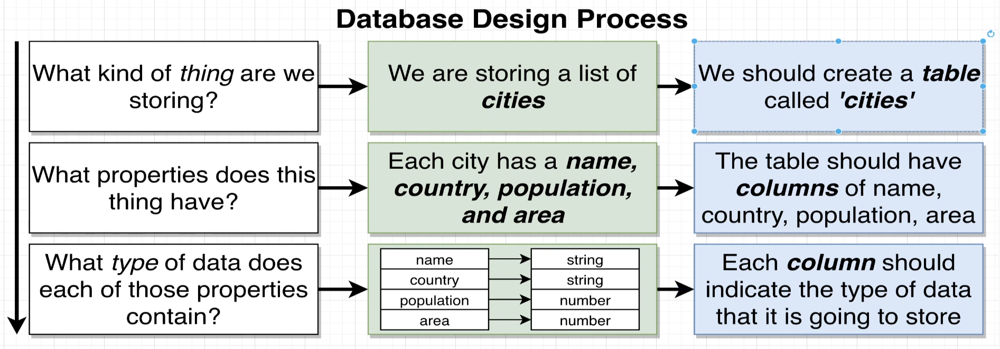

What are tables? We are only going to store data inside our database inside of tables. A table contains many records. Each record inside our table is referred to as a row.

<img src=attachment:f3248545-0758-4925-836e-ea3c97289b7f.png width=700 />
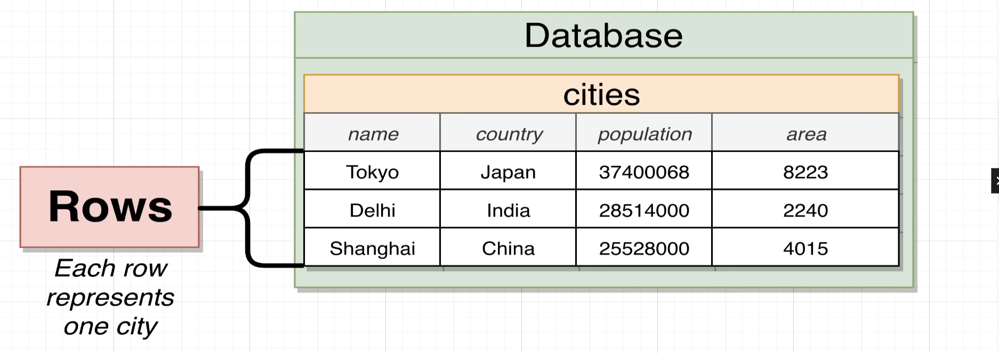

### Creating/Inserting into a Table

<img src=attachment:790477d9-a58a-4ad8-abdd-246669a9d340.png width=600 />
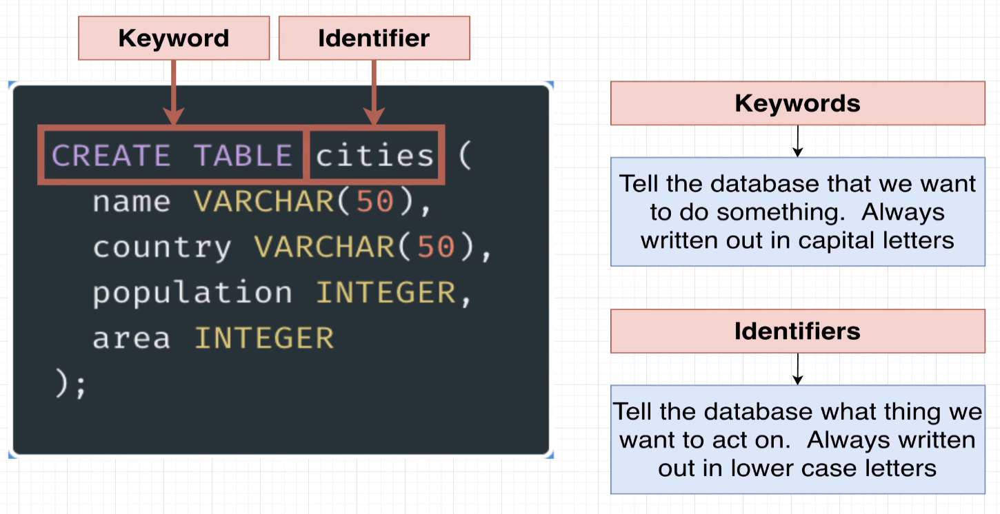

`VARCHAR(50)` is short for 'variable characters' tells us that we never expect to store a string longer than 50 characters, otherwise we'll get an error.

`INTEGER` are numbers between -2,147,483,647 to 2,147,483,647. We can't have bigger or smaller, otherwise error.

We can try out SQL code on the website: https://pg-sql.com/

To insert into our table, we use `INSERT INTO <name of table>(<column titles, comma separated>)` and `VALUES (<strings or integer values corresponding to the columns of our data>);`, e.g.  

```
INSERT INTO cities(name, country, population, area)
VALUES ('Tokyo', 'Japan', 38505000, 8223);
```

Values have to be provided in correspondence with `INSERT INTO`'s line. 

**We must have the `INSERT INTO` line every time we want to add records to our tables.**

### Retrieving Data with SELECT

Looking at the table we created above called cities, we retrieve all columns with the queries:

`SELECT * FROM <table name>` `SELECT <specific column names, comma-separated> FROM <table>`.

e.g. 

`SELECT name, population FROM cities;`. We can list the same column headings multiple times or play around with the order. We'll see an example of why this can be useful.

### Performing Calculations Before Pulling From Database

We had columns population and area for our `cities` table. Now let's say we want to calculate the population density for each row. We do this by imagining that we are creating a temporary column from our actual columns. We do this by writing:

`SELECT name, population / area FROM cities;` : These columns in postgres are labelled `?column?` because they're temporary columns, but we can rename it using the `AS` keyword.

```
SELECT name, population / area AS population_density
FROM cities;
```

### String Operators and Functions

Here are the string operators and functions:

<img src=attachment:f9b2fa82-2967-4a16-8358-5a106c9fc5c7.png width=800 />
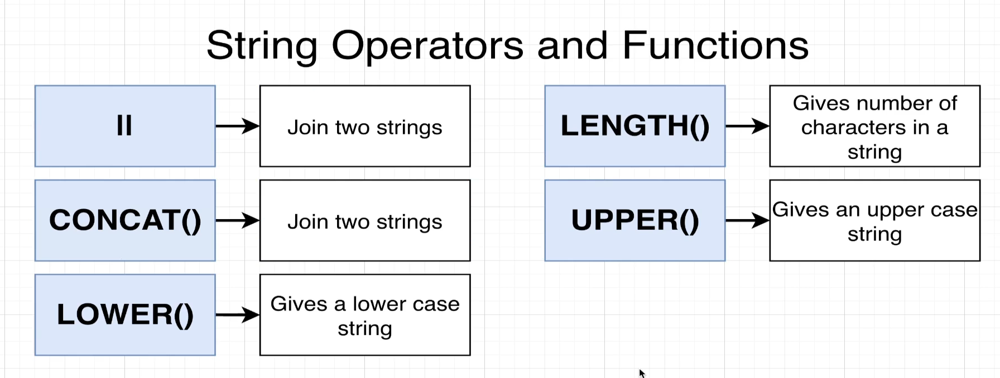

Here's an example:

`SELECT name || country FROM cities` - This joins together the cities and countries together as an undefined/temporay column e.g. TokyoJapan.

To format this better, we can change our code to:

`SELECT name || ', ' || country FROM cities;` - which outputs Tokyo, Japan. Don't forget that we can define this column with the `AS` keyword.

We can also use CONCAT():

`select CONCAT(name, ', ', country) AS location FROM cities;`

Finally, we can combine functions intuitively e.g. `CONCAT(UPPER(name)...)...`

## Section 2

### Filtering rows given some criteria using the 'WHERE' keyword: 

We can filter our data using `SELECT <column x> FROM <table> WHERE <condition>;`

e.g. `SELECT name, area from cities WHERE area > 4000;`

An extremely important point to note is understanding the order in which postgres interprets the keywords:

<img src=attachment:66bdce4a-cacb-4c63-a2c3-1af11e460e19.png width=750 />
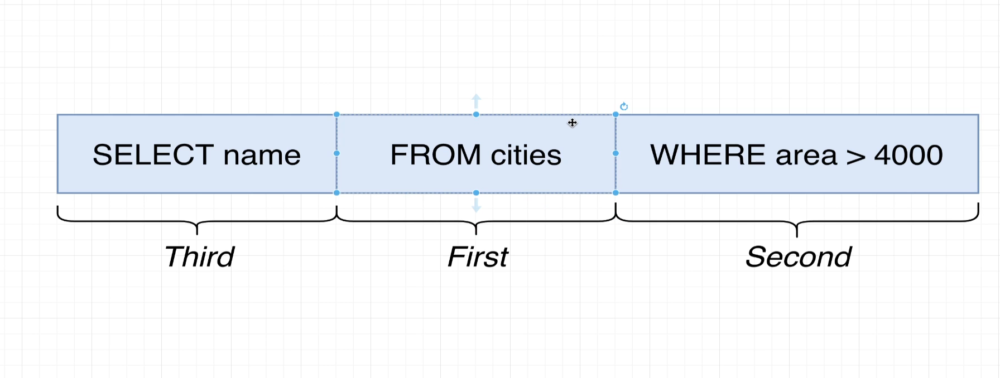

- It first looks in the `cities` table.
- Then, it says, for each row does it have a column with area above 4000?
- Then we select the column that we want from this filtered data.

Here are all the comparison operators:

<img src=attachment:023ebb97-ab5a-4bbb-a610-82caf243ba18.png width=750 />
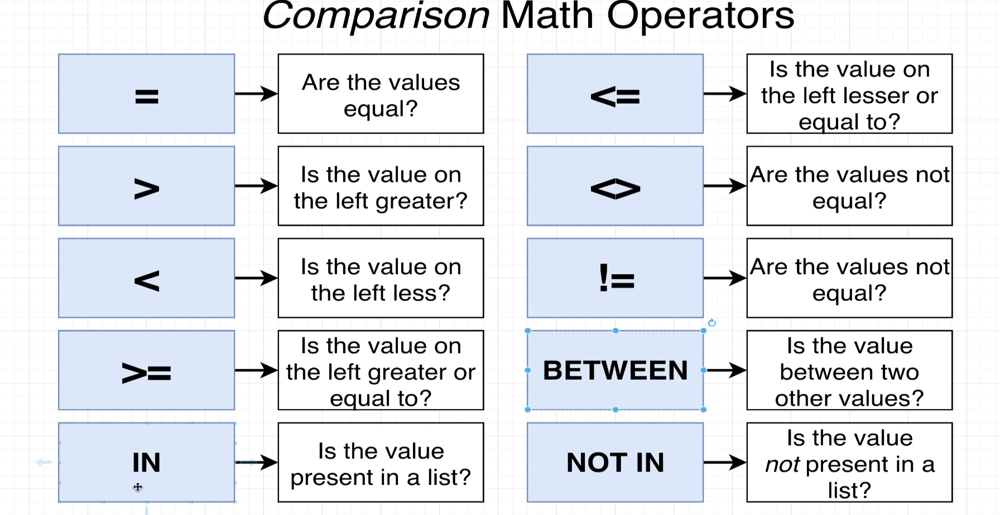

Here's an example with `BETWEEN`:

```
SELECT
    name,
    area
FROM
    cities
WHERE
    area BETWEEN 2000 and 4000
```

Here's an example with `IN`:

```
SELECT
    name,
    area
FROM
    cities
WHERE
    name IN ('Delhi', 'Shanghai');
```

This looks for every city within our specified list ('Delhi', 'Shanghai'). They don't need to be strings - we can search for specific integers too.

Multiple conditions can be done easily with the `AND`/`OR` keywords.

```
WHERE 
    area NOT IN (3043, 8223) 
    AND name = 'Delhi'
    OR name = 'Tokyo';
```

Note that AND has precedence over OR so `WHERE a1 OR a2 AND b,` is interpreted as `WHERE a1 or (a2 AND b)`. In general, use parentheses to make it clear.

### Updating Rows

When we want to update records, we don't use the `SELECT` keyword because we're not fetching any data, we're only trying to update.

`UPDATE <table> SET <column heading> = <value> WHERE <condition`

Example: `UPDATE cities SET population = 39505000 WHERE name = 'Tokyo';`

### Deleting Rows

Here we use: - `DELETE FROM <table> WHERE <condition>;`: Deletes the entire row of any record satisfying the condition.

e.g. `DELETE FROM cities WHERE name = 'Tokyo';`

## Section 3

### Approaching Database Design (Multiple Tables)

Here is something more realistic:

<img src=attachment:f101423a-322e-40be-82c1-fa97f5608207.png width=700 />
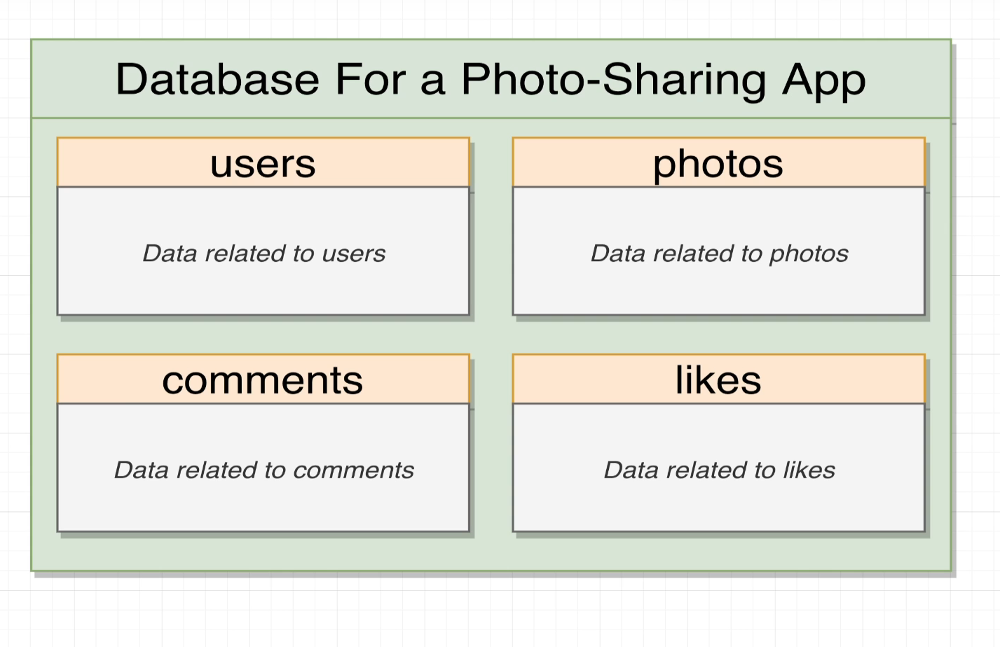

**If the feature is widely used, we can google to find the appropriate structure (schema) e.g. for an upvoting/downvoting system, we could google: SQL scheme upvote system.**

**If the feature is new, we should start by creating a separate table for each of these features; features that seems to indicate a relationship/ownership need to be reflected in our table design**

Here's an example for an Instagram account :

<img src=attachment:ca785eb0-6334-471d-beb9-c8265346dd6a.png width=700 />

We note that there is a relationship between users; users can follow others but not themselves. We also note that users *own* those photos.
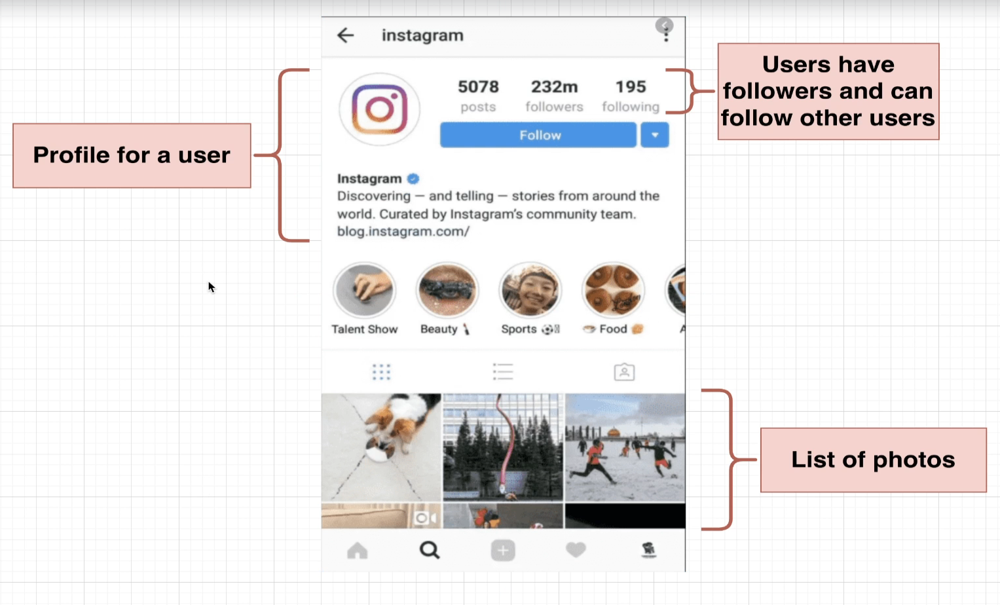

Here's an example of an Instagram post:

<img src=attachment:dad79093-e70a-4591-a241-251eeb46e899.png width=700 />

We note that comments are specifically intended for that photo/post. There's also a relationship between a user and a 'like' resource, and a 'like resource' and a photo. 

We can loosely describe these relationships:

<img src=attachment:0c5e061d-0145-422c-bb11-ec0703198457.png width=750 />
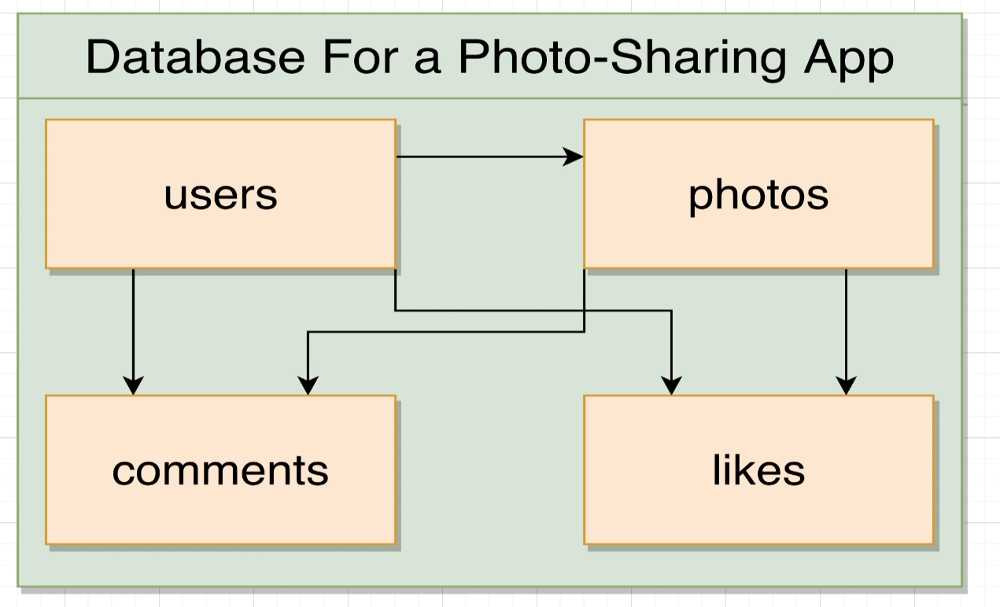
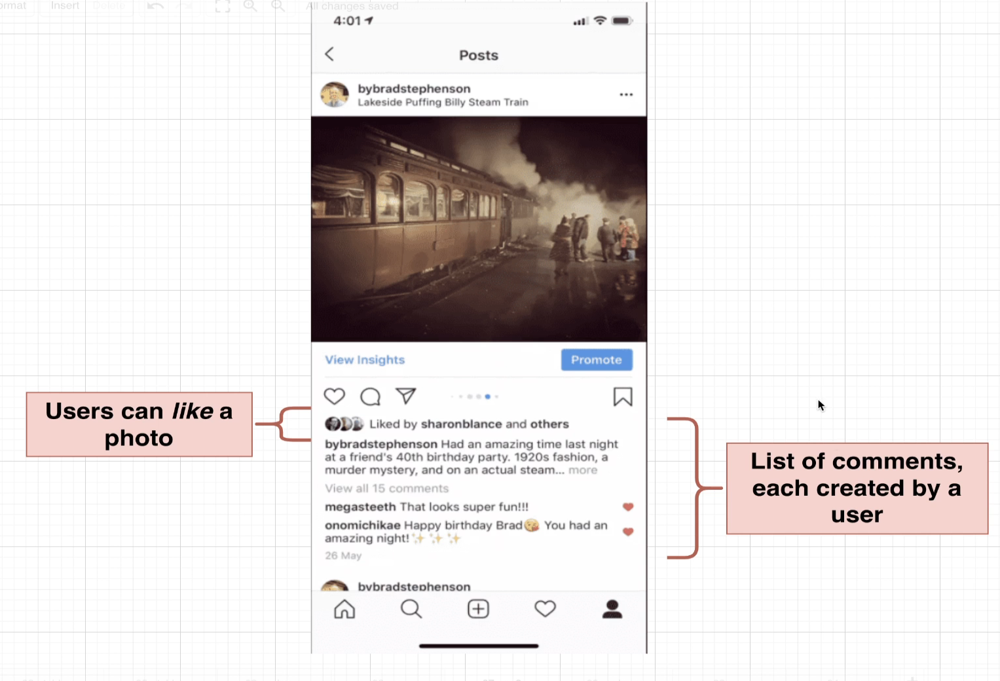

There are **4 different kinds of relationships** that we can make between records in SQL.

- One-to-Many: (a user has many photos)
- Many-to-One: (many photos have one user - technically we say a photo has one user because this indicates that a photo cannot have multiple users)
- One-to-One: (a boat has one captain, a company has one CEO, a person has driver's license)
- Many-to-Many: (students have many classes + classes have many students, players have many matches + matches have many players etc.)

To reflect these relationships we need **primary keys** and **foreign keys**.

### Primary and Foreign Keys

Primary and foreign keys are additional columns added to many tables that we create. Every single table we make will have a primary key (column)

**Primary key**: The goal of this is to uniquely identify a row in a given table. Therefore, all rows in a given table have a unique primary key.

**Foreign key**: The goal of this is to somehow relate a row in one table to some other row in a different table, or even the same table.

<img src=attachment:55f2859c-2c21-4812-bb05-b74d70f73a6e.png width=700 />



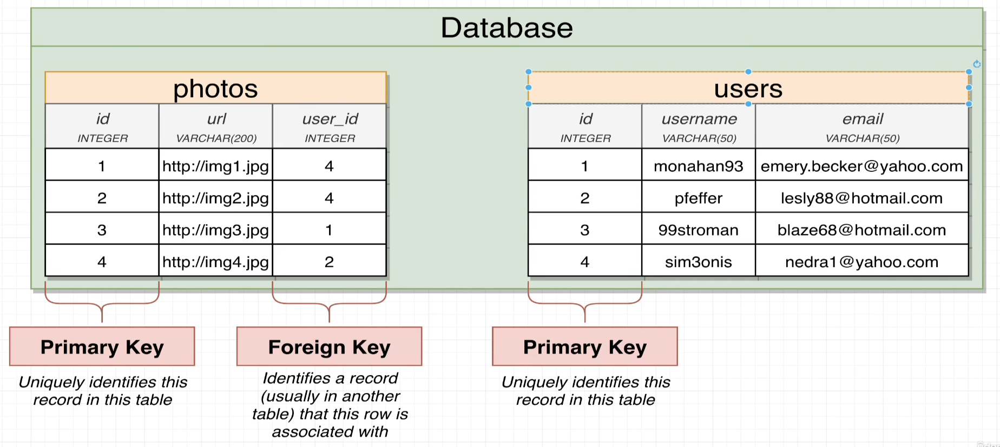

The photos table's foreign key column tells us that the first two photos with `user_id = 4` is somehow related to the user with `id = 4`, i.e. sim3onis. **This is how we implement a one-to-many and many-to-one relationship**. Remember that these two relationships are very similar - it just depends on the perspective.

How do we decide which table gets the foreign key column?

Let's take a look at the Instagram example:

<img src=attachment:c333137a-e0bb-4c25-96b8-a0ada58d90b3.png width=700 />
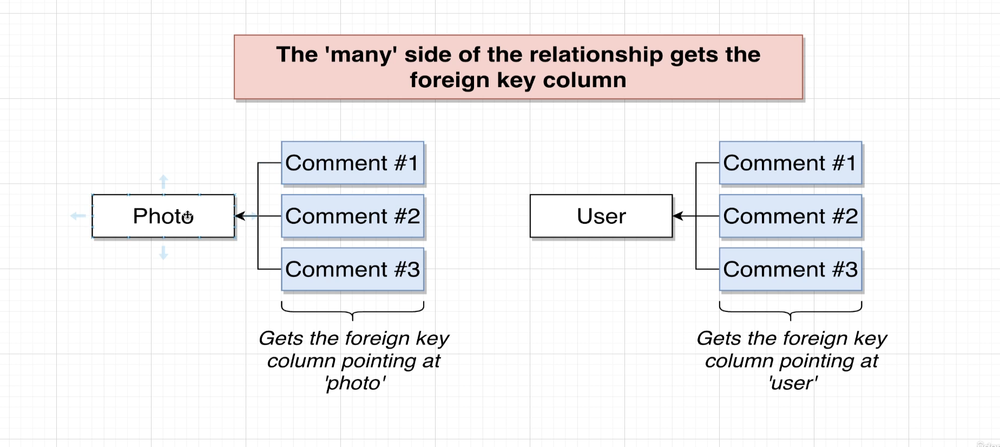

**The 'many' side of the relationship gets the foreign key column**

<img src=attachment:118b4d5f-12ce-4c38-b254-e13ee72dd858.png width=700 />

Here we can see that comments has two owners, both of which have a many-to-one type relationship from the perspective of the comment, so the comments table has two foreign key columns.

Also, photos have a many-to-one relationship with users, so photos table gets the foreign key column.
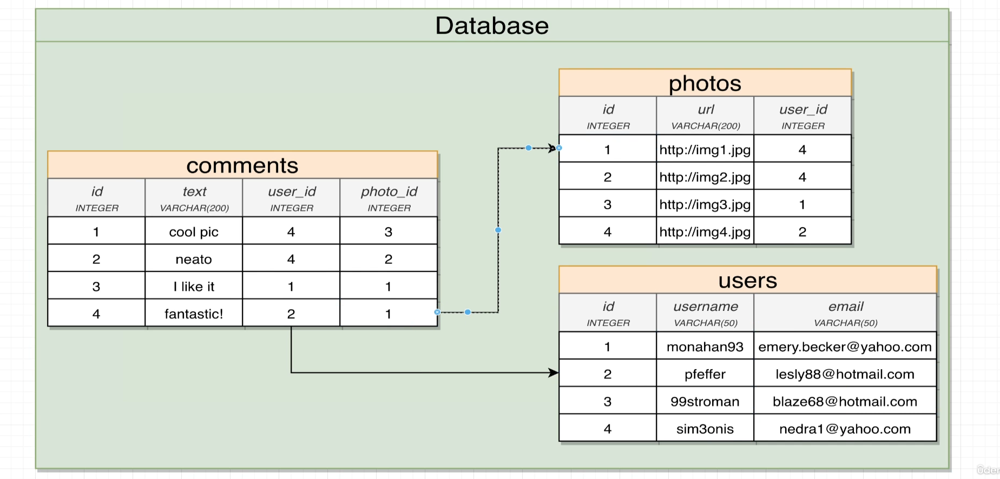

The table below summarises the properties of the two types of keys:

<img src=attachment:a30f7528-835c-44d7-9da6-749e50b4f649.png width=750 />
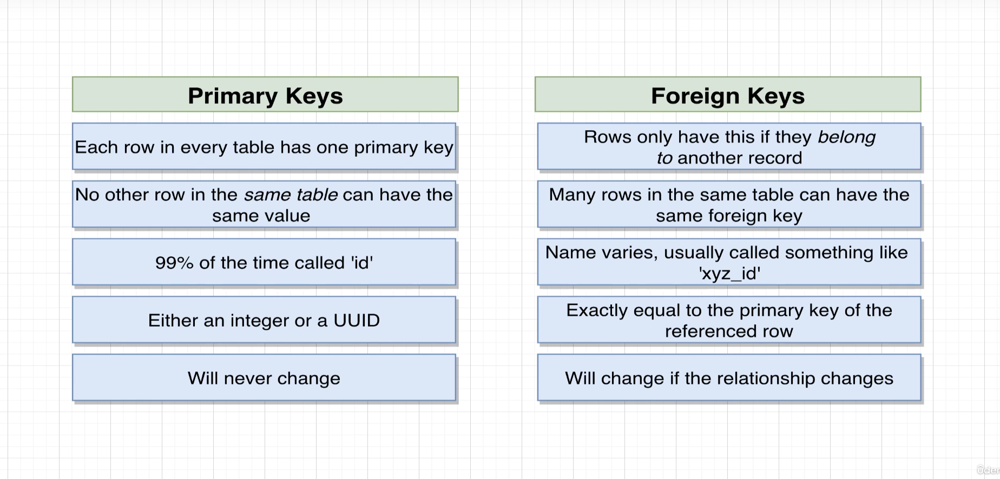

### Creating primary and foreign key columns in SQL

**Primary keys** : To automatically give each of our rows a primary key, we can use the keyword `SERIAL` (instead of something like VARCHAR(50) or INTEGER). This means we don't need to provide the ID; as soon as we generate a row of data, SQL will automatically generate a unique ID. After `SERIAL` we can add the `PRIMARY KEY` keyword which gives us performance benefits.

```
CREATE TABLE users (
    id SERIAL PRIMARY KEY,
    username VARCHAR(50)
);
```

If we want to insert rows into this, we don't need to provide the id column because of the `SERIAL` keyword. Also `id` in the above is not a keyword - we could call it `idd` if we wanted.

```
INSERT INTO users (username)
VALUES
    ('john'),
    ('paul'),
    ('george'),
    ('ringo');
```

**Foreign keys**: To make a foreign key column we need the `REFERENCES` keyword as well as the table and column that it's referencing. Here's an example:

```
CREATE TABLE photos (
    id SERIAL PRIMARY KEY,
    url VARCHAR(200),
    user_id INTEGER REFERENCES users(id)
);
```

Now let's insert a row that has a foreign key. 

```
INSERT INTO photos (url, user_id)
VALUES 
    ('http://one.jpg', 1),
    ('http://121.jpg', 1),
    ('http://423.jpg', 1),
    ('http://223.jpg', 2),
    ('http://321.jpg', 3),
    ('http://534.jpg', 4),
    ('http://453.jpg', 4);
```

### Querying and the keyword `JOIN`

Now let's write a query to retreive all photos created by user 4: `SELECT * FROM photos WHERE user_id = 4;`

The`JOIN` statement is one of the most difficult concepts to understand in SQL. We'll introduce it without explanation now and see it in more detail later.

Firstly, let's take a look at the query:

```
SELECT url, username FROM photos
JOIN users on users.id = photos.user_id;
```

Output: 

<img src=attachment:bb5d4b31-1cdf-4656-9c17-ee069ff01a18.png width=600 />

Note:
- `url` is from the `photos` table while `username` is from the `users` table.
- The `JOIN` statement above is combining together the definitions of the two different tables.
- This query is useful for finding the photos associated with a given user (e.g. instagram).

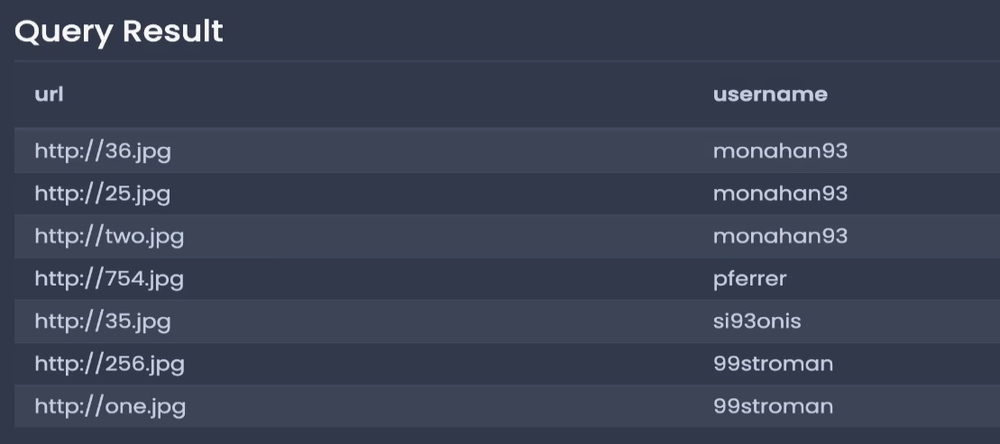

### Foreign Key constraint around insertion, deletion and updating.

**Insertion**

Postgres won't let us insert some photo which belongs to a user that is not present in our table. If we have 4 users with IDs ranging from 1 to 4, then trying to add a new photo and associating it with a user who has ID = 9999 will produce an error.

What if we wanted to add a photo to our table but not have it associated with any user at all. We can do that with the keyword `NULL`.

For example:

```
INSERT INTO photos (url, user_id)
VALUES ('http://universal.jpg', NULL);
```

**Deletion**

If we ever delete a user, say user with ID (primary key) of 1, then there will never ever be another user with an ID of 1 again. 

This is because we used serialisation. Postgres can deal with this is in a number of ways:

<img src=attachment:77af9ccd-1366-41ac-b822-f6b5b1a6567d.png width=500 />


The **first** option is the default. If we try to delete a user who is associated with a number of photos, then, we get an error:

```
DELETE FROM users
WHERE id = 1;
```

Output: Error (violates foreign key constrain)

The **second** option is very similar to the first; we'll take a look at that later.

The **third** option will delete the photos too.

The **fourth** option sets those photos' value to NULL.

The **fifth** option will set the photos' value to whatever default value that we chose earlier on.
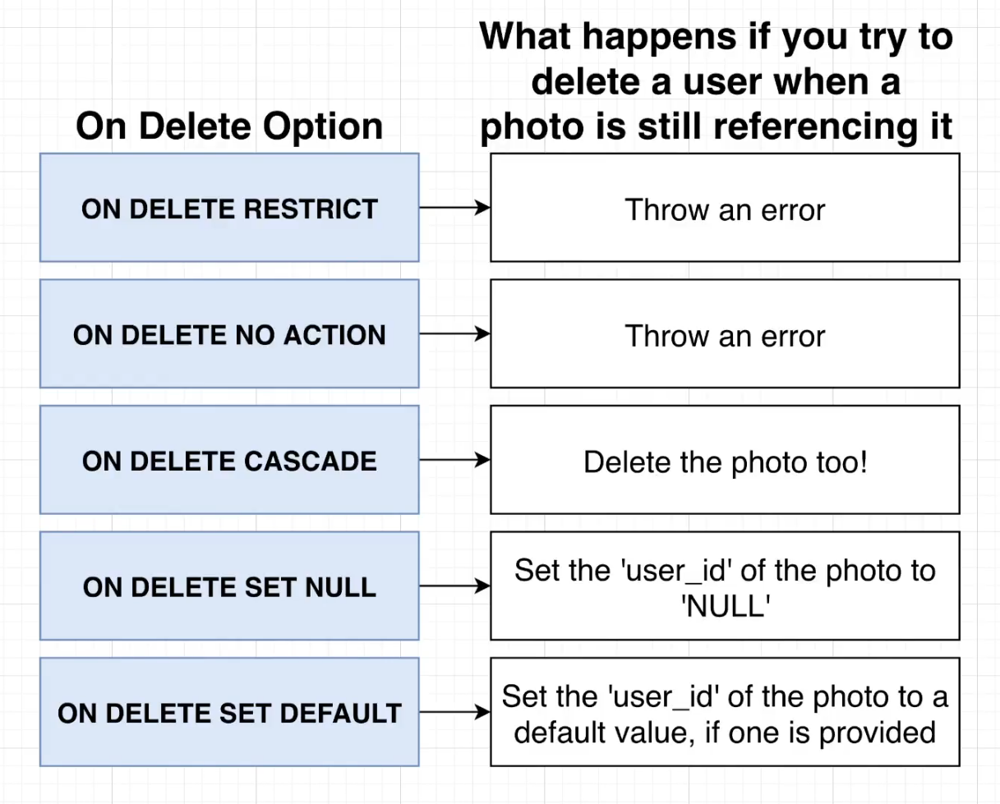

**Here's some code that we're going to use multiple times for learning `DELETE`**:

```
CREATE TABLE users (
  id SERIAL PRIMARY KEY,
  username VARCHAR(50)
);

INSERT INTO users (username)
VALUES
    ('monahan93'),
    ('pferrer'),
    ('si93onis'),
    ('99stroman');



CREATE TABLE photos (
id SERIAL PRIMARY KEY,
url VARCHAR(200),
user_id INTEGER REFERENCES users(id)
);
 
INSERT INTO photos (url, user_id)
VALUES
('http:/one.jpg', 4),
('http:/two.jpg', 1),
('http:/25.jpg', 1),
('http:/36.jpg', 1),
('http:/754.jpg', 2),
('http:/35.jpg', 3),
('http:/256.jpg', 4);
```

Firstly, to delete a table in Postgres, we use the keyword `DROP`:

`DROP TABLE photos;`

To set the delete behaviour, we must add one of the keywords during the `CREATE TABLE` phase. Let's set the delete behaviour to `ON DELETE CASCADE`. To do this, we must add the keyword **right after our foreign key definition**. For example, our new `CREATE TABLE` SQL query will be:

```
CREATE TABLE photos (
id SERIAL PRIMARY KEY,
url VARCHAR(200),
user_id INTEGER REFERENCES users(id) ON DELETE CASCADE
);
```

This isn't doing any deleting - it's just setting up the delete behaviour. Later on, when we do `DELETE FROM users WHERE id = 1`, it will ensure that tables which contain a foreign key column that points to users with id = 1 (user_id = 1) - those corresponding rows will be deleted. Below, we've deleted user 1 and therefore the 3 rows in the photos table get deleted.

<img src=attachment:44f17654-5f10-4cd3-be1f-dd832efb6f6d.png width=600 />
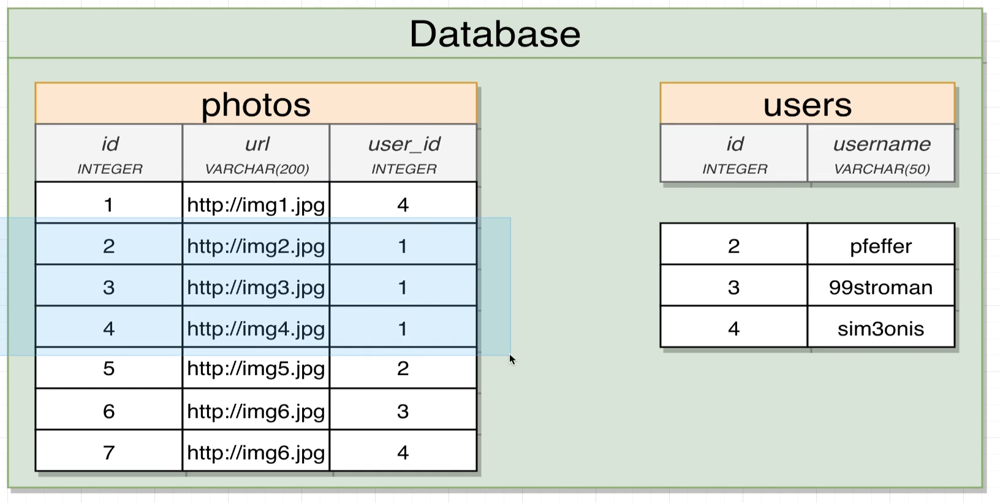

There's one more example in the videos (41.) for the ON DELETE SET NULL behaviour. 

## Section 4

### Adding Data

Note: A **schema diagram** shows the structure of our database. This scheme will contain the all the tables within, as well as their relationships.

Here is a schema for a database of users, photos and comments: 

<img src=attachment:81d18015-f11e-4bec-a058-6ec64a715c69.png width=650 />
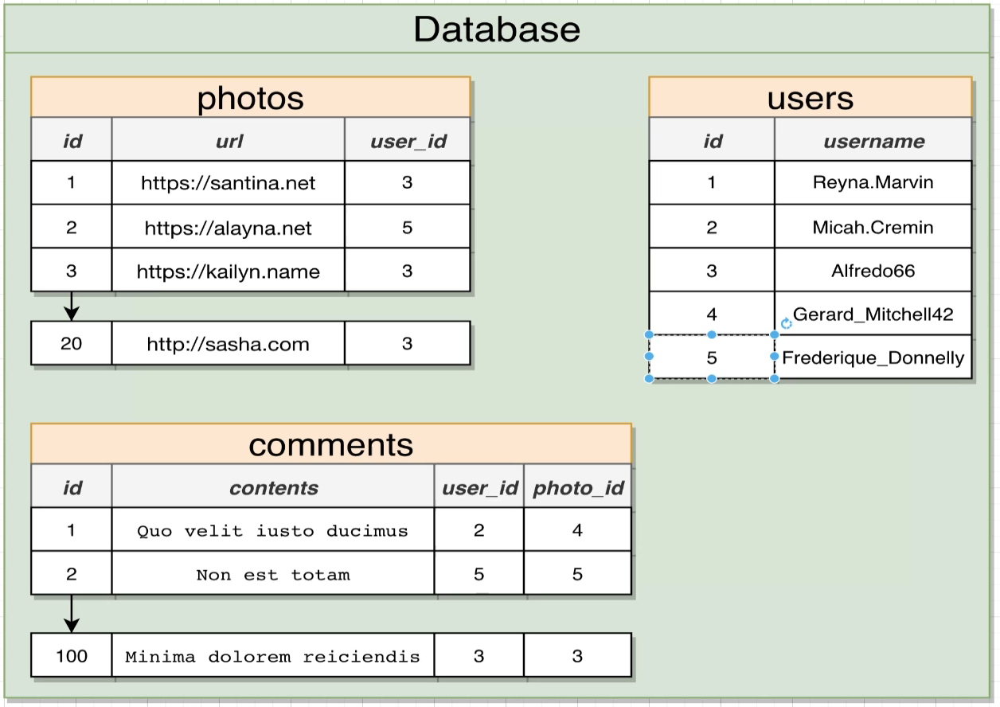

And here is the code:

```
CREATE TABLE users(
  id SERIAL PRIMARY KEY,
  username VARCHAR(50)
);
 
CREATE TABLE photos (
  id SERIAL PRIMARY KEY,
  url VARCHAR(200),
  user_id INTEGER REFERENCES users(id) ON DELETE CASCADE
);
 
CREATE TABLE comments (
  id SERIAL PRIMARY KEY,
  contents VARCHAR(240),
  user_id INTEGER REFERENCES users(id) ON DELETE CASCADE,
  photo_id INTEGER REFERENCES photos(id) ON DELETE CASCADE
);
 
INSERT INTO users (username) 
VALUES 
        ('Reyna.Marvin'),
        ('Micah.Cremin'),
        ('Alfredo66'),
        ('Gerard_Mitchell42'),
        ('Frederique_Donnelly');
 
INSERT INTO photos (url, user_id)
VALUES
        ('https://santina.net', 3),
        ('https://alayna.net', 5),
        ('https://kailyn.name', 3),
        ('http://marjolaine.name', 1),
        ('http://chet.net', 5),
        ('http://jerrold.org', 2),
        ('https://meredith.net', 4),
        ('http://isaias.net', 4),
        ('http://dayne.com', 4),
        ('http://colten.net', 2),
        ('https://adelbert.biz', 5),
        ('http://kolby.org', 1),
        ('https://deon.biz', 2),
        ('https://marina.com', 5),
        ('http://johnson.info', 1),
        ('https://linda.info', 2),
        ('https://tyrique.info', 4),
        ('http://buddy.info', 5),
        ('https://elinore.name', 2),
        ('http://sasha.com', 3);
 
INSERT INTO comments (contents, user_id, photo_id)
VALUES
        ('Quo velit iusto ducimus quos a incidunt nesciunt facilis.', 2, 4),
        ('Non est totam.', 5, 5),
        ('Fuga et iste beatae.', 3, 3),
        ('Molestias tempore est.', 1, 5),
        ('Est voluptatum voluptatem voluptatem est ullam quod quia in.', 1, 5),
        ('Aut et similique porro ullam.', 1, 3),
        ('Fugiat cupiditate consequatur sit magni at non ad omnis.', 1, 2),
        ('Accusantium illo maiores et sed maiores quod natus.', 2, 5),
        ('Perferendis cumque eligendi.', 1, 2),
        ('Nihil quo voluptatem placeat.', 5, 5),
        ('Rerum dolor sunt sint.', 5, 2),
        ('Id corrupti tenetur similique reprehenderit qui sint qui nulla tenetur.', 2, 1),
        ('Maiores quo quia.', 1, 5),
        ('Culpa perferendis qui perferendis eligendi officia neque ex.', 1, 4),
        ('Reprehenderit voluptates rerum qui veritatis ut.', 1, 1),
        ('Aut ipsum porro deserunt maiores sit.', 5, 3),
        ('Aut qui eum eos soluta pariatur.', 1, 1),
        ('Praesentium tempora rerum necessitatibus aut.', 4, 3),
        ('Magni error voluptas veniam ipsum enim.', 4, 2),
        ('Et maiores libero quod aliquam sit voluptas.', 2, 3),
        ('Eius ab occaecati quae eos aut enim rem.', 5, 4),
        ('Et sit occaecati.', 4, 3),
        ('Illum omnis et excepturi totam eum omnis.', 1, 5),
        ('Nemo nihil rerum alias vel.', 5, 1),
        ('Voluptas ab eius.', 5, 1),
        ('Dolor soluta quisquam voluptatibus delectus.', 3, 5),
        ('Consequatur neque beatae.', 4, 5),
        ('Aliquid vel voluptatem.', 4, 5),
        ('Maiores nulla ea non autem.', 4, 5),
        ('Enim doloremque delectus.', 1, 4),
        ('Facere vel assumenda.', 2, 5),
        ('Fugiat dignissimos dolorum iusto fugit voluptas et.', 2, 1),
        ('Sed cumque in et.', 1, 3),
        ('Doloribus temporibus hic eveniet temporibus corrupti et voluptatem et sint.', 5, 4),
        ('Quia dolorem officia explicabo quae.', 3, 1),
        ('Ullam ad laborum totam veniam.', 1, 2),
        ('Et rerum voluptas et corporis rem in hic.', 2, 3),
        ('Tempora quas facere.', 3, 1),
        ('Rem autem corporis earum necessitatibus dolores explicabo iste quo.', 5, 5),
        ('Animi aperiam repellendus in aut eum consequatur quos.', 1, 2),
        ('Enim esse magni.', 4, 3),
        ('Saepe cumque qui pariatur.', 4, 4),
        ('Sit dolorem ipsam nisi.', 4, 1),
        ('Dolorem veniam nisi quidem.', 2, 5),
        ('Porro illum perferendis nemo libero voluptatibus vel.', 3, 3),
        ('Dicta enim rerum culpa a quo molestiae nam repudiandae at.', 2, 4),
        ('Consequatur magnam autem voluptas deserunt.', 5, 1),
        ('Incidunt cum delectus sunt tenetur et.', 4, 3),
        ('Non vel eveniet sed molestiae tempora.', 2, 1),
        ('Ad placeat repellat et veniam ea asperiores.', 5, 1),
        ('Eum aut magni sint.', 3, 1),
        ('Aperiam voluptates quis velit explicabo ipsam vero eum.', 1, 3),
        ('Error nesciunt blanditiis quae quis et tempora velit repellat sint.', 2, 4),
        ('Blanditiis saepe dolorem enim eos sed ea.', 1, 2),
        ('Ab veritatis est.', 2, 2),
        ('Vitae voluptatem voluptates vel nam.', 3, 1),
        ('Neque aspernatur est non ad vitae nisi ut nobis enim.', 4, 3),
        ('Debitis ut amet.', 4, 2),
        ('Pariatur beatae nihil cum molestiae provident vel.', 4, 4),
        ('Aperiam sunt aliquam illum impedit.', 1, 4),
        ('Aut laudantium necessitatibus harum eaque.', 5, 3),
        ('Debitis voluptatum nesciunt quisquam voluptatibus fugiat nostrum sed dolore quasi.', 3, 2),
        ('Praesentium velit voluptatem distinctio ut voluptatum at aut.', 2, 2),
        ('Voluptates nihil voluptatum quia maiores dolorum molestias occaecati.', 1, 4),
        ('Quisquam modi labore.', 3, 2),
        ('Fugit quia perferendis magni doloremque dicta officia dignissimos ut necessitatibus.', 1, 4),
        ('Tempora ipsam aut placeat ducimus ut exercitationem quis provident.', 5, 3),
        ('Expedita ducimus cum quibusdam.', 5, 1),
        ('In voluptates doloribus aut ut libero possimus adipisci iste.', 3, 2),
        ('Sit qui est sed accusantium quidem id voluptatum id.', 1, 5),
        ('Libero eius quo consequatur laudantium reiciendis reiciendis aliquid nemo.', 1, 2),
        ('Officia qui reprehenderit ut accusamus qui voluptatum at.', 2, 2),
        ('Ad similique quo.', 4, 1),
        ('Commodi culpa aut nobis qui illum deserunt reiciendis.', 2, 3),
        ('Tenetur quam aut rerum doloribus est ipsa autem.', 4, 2),
        ('Est accusamus aut nisi sit aut id non natus assumenda.', 2, 4),
        ('Et sit et vel quos recusandae quo qui.', 1, 3),
        ('Velit nihil voluptatem et sed.', 4, 4),
        ('Sunt vitae expedita fugiat occaecati.', 1, 3),
        ('Consequatur quod et ipsam in dolorem.', 4, 2),
        ('Magnam voluptatum molestias vitae voluptatibus beatae nostrum sunt.', 3, 5),
        ('Alias praesentium ut voluptatem alias praesentium tempora voluptas debitis.', 2, 5),
        ('Ipsam cumque aut consectetur mollitia vel quod voluptates provident suscipit.', 3, 5),
        ('Ad dignissimos quia aut commodi vel ut nisi.', 3, 3),
        ('Fugit ut architecto doloremque neque quis.', 4, 5),
        ('Repudiandae et voluptas aut in excepturi.', 5, 3),
        ('Aperiam voluptatem animi.', 5, 1),
        ('Et mollitia vel soluta fugiat.', 4, 1),
        ('Ut nemo voluptas voluptatem voluptas.', 5, 2),
        ('At aut quidem voluptatibus rem.', 5, 1),
        ('Temporibus voluptates iure fuga alias minus eius.', 2, 3),
        ('Non autem laboriosam consectetur officiis aut excepturi nobis commodi.', 4, 3),
        ('Esse voluptatem sed deserunt ipsum eaque maxime rerum qui.', 5, 5),
        ('Debitis ipsam ut pariatur molestiae ut qui aut reiciendis.', 4, 4),
        ('Illo atque nihil et quod consequatur neque pariatur delectus.', 3, 3),
        ('Qui et hic accusantium odio quis necessitatibus et magni.', 4, 2),
        ('Debitis repellendus inventore omnis est facere aliquam.', 3, 3),
        ('Occaecati eos possimus deleniti itaque aliquam accusamus.', 3, 4),
        ('Molestiae officia architecto eius nesciunt.', 5, 4),
        ('Minima dolorem reiciendis excepturi culpa sapiente eos deserunt ut.', 3, 3);
```

### Joins and Aggregations

Here are some questions that we may want to answer:

- Find all comments for the photo with ID = 3, along with the username of the author.
- Find the photo with ID = 10 and get the number of comments attached to it.
- Find the user with the most activity (most comments + most photos).
- Calculate the average number of characters per comment.
- Find the average number of comments per photo.
- Find the photo with the most comments attached to it.

To answer them, we need to use techniques known as **joins** and **aggregations**.

<img src=attachment:89bde5ff-d665-4487-b778-2cab3315940d.png width=700 />

The first 3 questions will likely need a **join** whilst the last 3 will likely need **aggregation**.
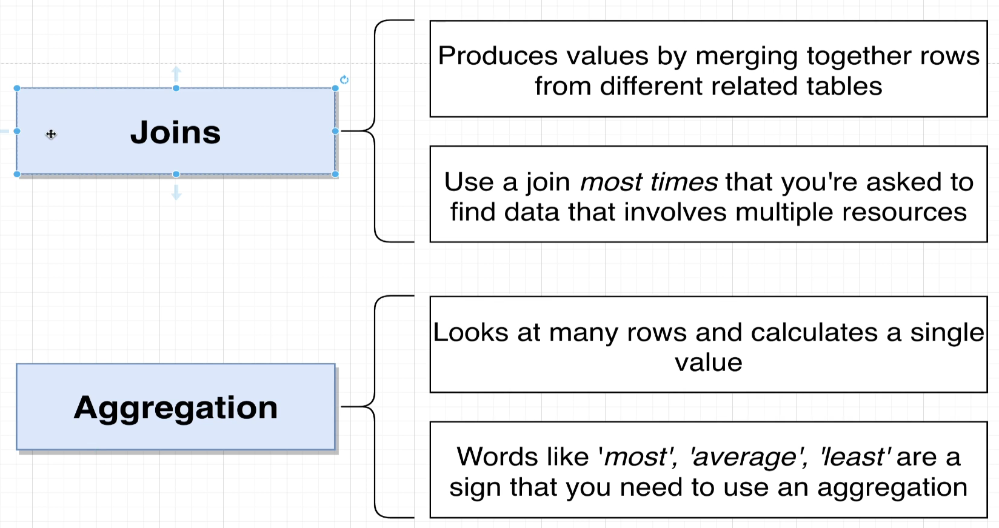

### Joins

**Join Example:**

Question: For each comment, show the contents of the comment and the username of the user who wrote the comment.

<img src=attachment:6a72fc4c-0bd2-494b-8af1-096168111033.png width=300 />
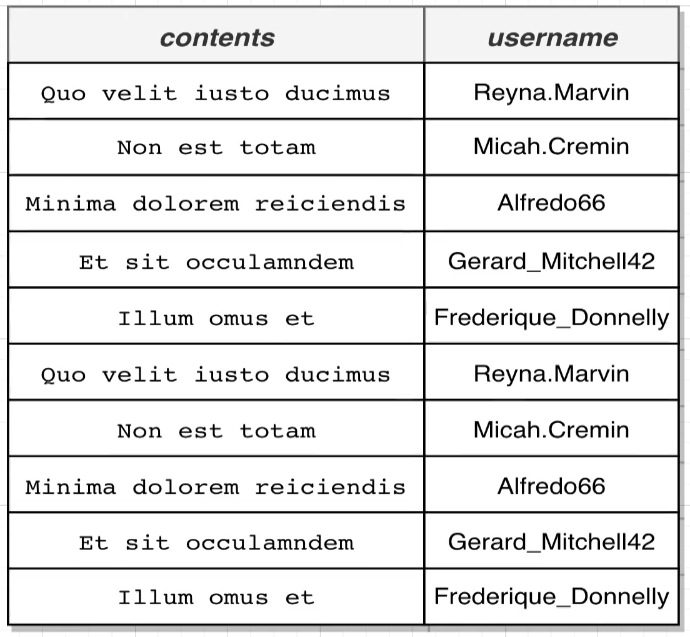

Now refer back to the schema above. The idea is that we want to take each comment, then go to the associated `user_id` and use that to access the associated user in the `users` table.

Here is the solution query that we're going to explain:

```
SELECT contents, username
FROM comments
JOIN users ON users.id = comments.user_id;
```

1. Remember that the `FROM comments` line executes first in SQL. This does the initial selection of the rows that we want to operate on. Currently we've selected all the different rows from `comments`. It may be useful to think that SQL has created a temporary table of the `comments` table.

2. Then, the `JOIN users on users.id = comments.user_id` executes. `JOIN users` immediately tells SQL that we want to combine information from the currently selected rows (temporary `comments` table) with the rows in `users`. Our temporary table now becomes 'titled' as "comments with users" because of the `join users`. 

3. Now SQL will iterate through each row in our temporary table. It will take a look at each user_id (`comments.user_id`). Then, it will go into the `users` table and find the row with the matching `id`.

<img src=attachment:06c89497-d90a-4298-8184-6f31f2517f77.png width=500 />

4. After all iterations are complete, we can now select the columns that we want. Here we `SELECT contents, username` which selects those two columns in that order. Those are then outputted. If we wanted, we could also pull out the `photo_id` column because it exists in our temporary table. This is because the temporary table originated from our comments table (see `FROM comments` line).

Quick tip: It may be useful to think of `JOIN users` as firstly adding the column headings of the `users` table to our temporary table.
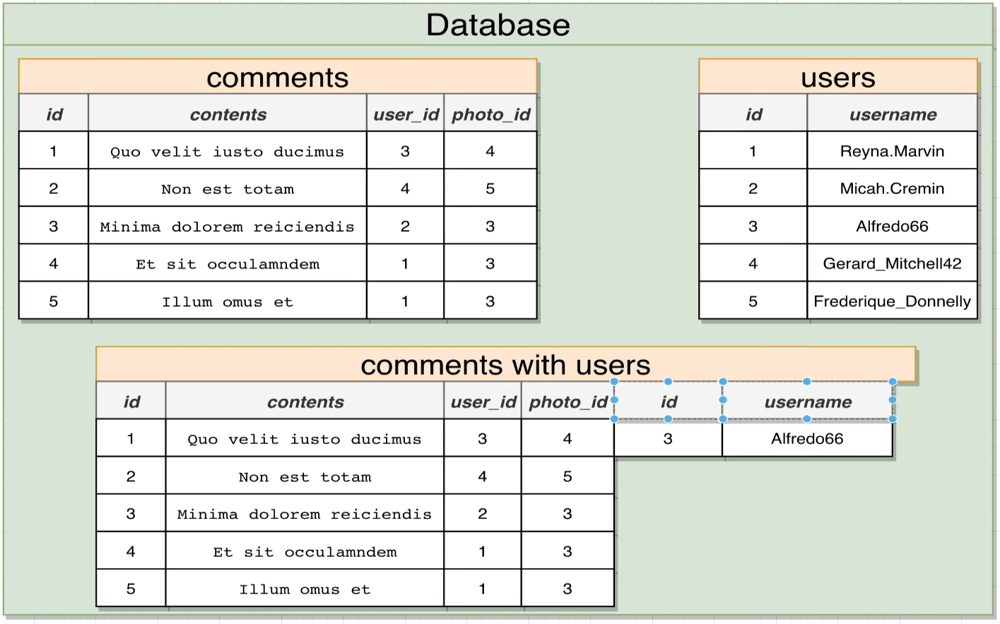

<img src=attachment:c6e59229-86c5-431b-ad38-31076c14a6d9.png width=500 />

1. Regarding the first note, we'll see more on it soon.

2. If we look at the above image, we can see two `id` columns: one from `comments` and one from `users`. So, if we had say `SELECT id`, we'll get an error because it could refer to either one. To solve this, we need to be more specific e.g. `SELECT comments.id`.

3. If we find that our query is verbose, we can use the `AS` keyword to give our headings a new name. We must replace **all** instances of this heading in our query. So, 
```
SELECT comments.id, photos.id
FROM photos
JOIN comments ON photos.id = comments.user_id;
```
could become
```
SELECT comments.id, p.id
FROM photos AS p
JOIN comments ON p.id = comments.photo_id; # we can't change photo_id here to p_id because it refers to a specific column name.
```

In fact, we can abbreviate this further by dropping the `AS`: `FROM photos AS p` -> `FROM photos p`, but it usually is better to keep the `AS` keyword.

4. This is related to the first point - we'll explore both below in **Missing Data in Joins**.
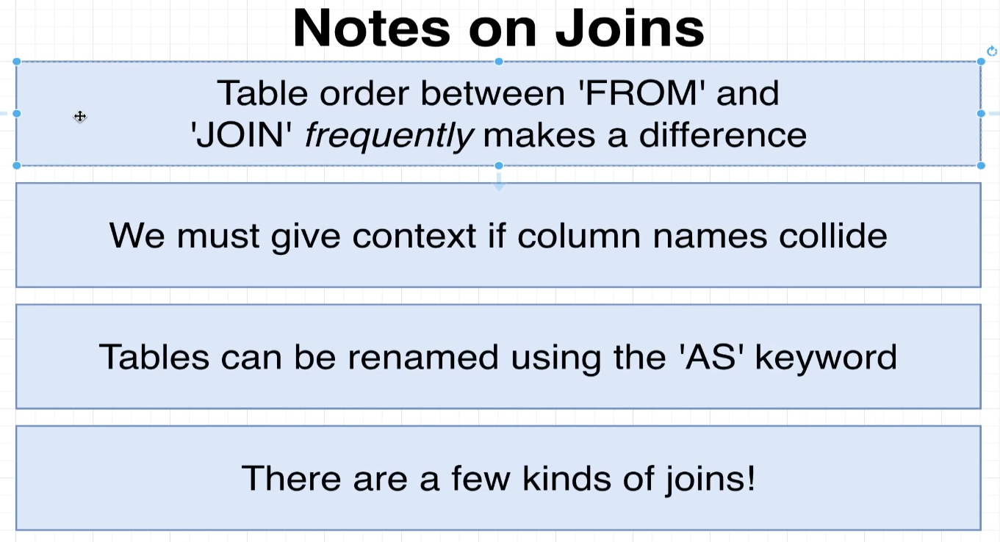

#### Missing Data in Joins

With the `FROM x` line, we expect to iterate through all rows in `x`, therefore, we should expect every row in `x` to be in the temporary table. But what if `x` has a foreign key value of `NULL`. 

For example:

<img src=attachment:16c6c34e-8f97-4b21-9809-94eb7fd32509.png width=450 />

But since this `NULL` will never equate to some `id` in the users table, the result is that **this row will not be not included in our output**. This is a problem because we iterated through all rows so we expect all rows to be in the final output. We may also want to know the total amount of rows in our photos etc., but this method will not work for it. This issue occurred because of the type of `JOIN` that we used: it automatically removes all rows where the match was unsuccessful.
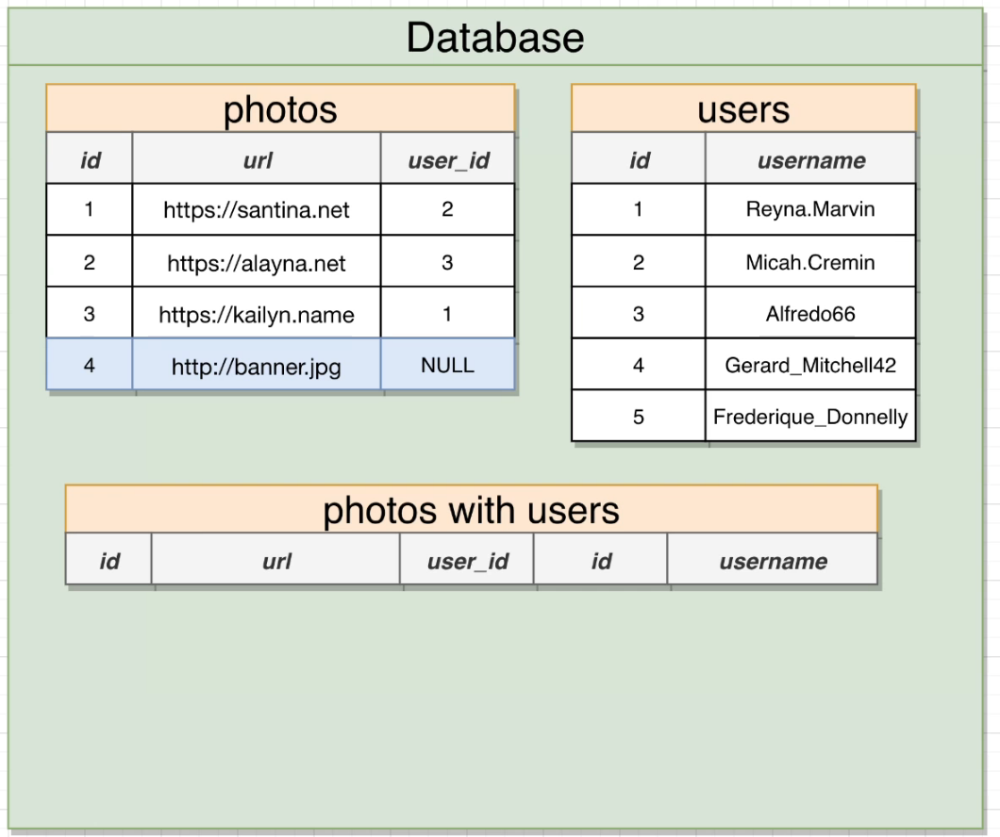

#### Four Kinds of Joins

This section will contain a lot of information that you'd likely refer to multiple times. Here's a quick cheatsheet of the four.

<img src=attachment:68a97d4c-9115-49b1-aefb-121331bf81a9.png width=600 />

<img src=attachment:dd92428e-b40e-474b-b18f-e52457ebf936.png width=600 />
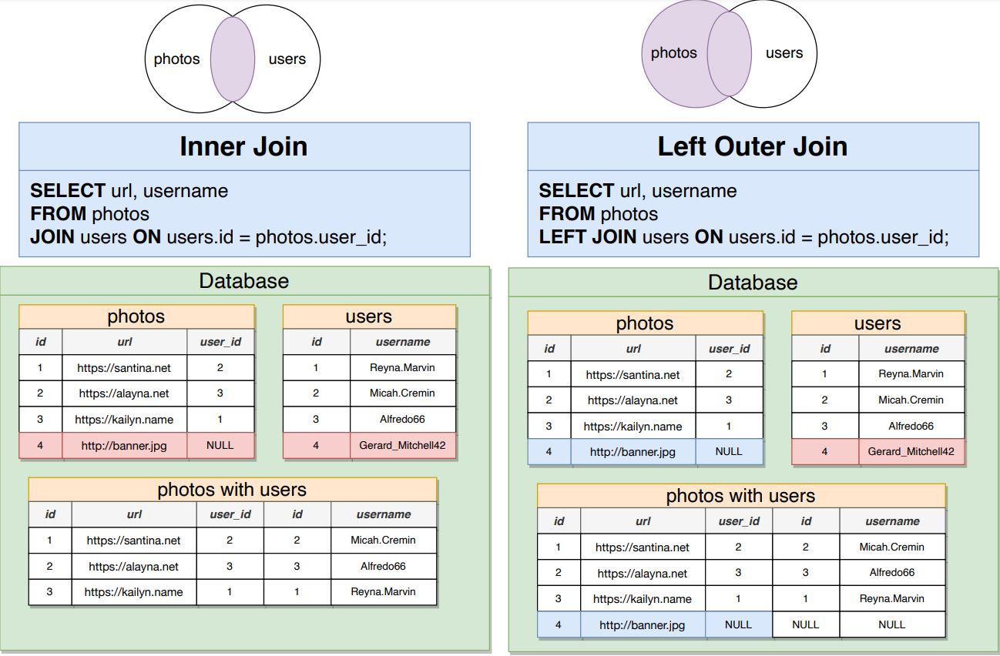
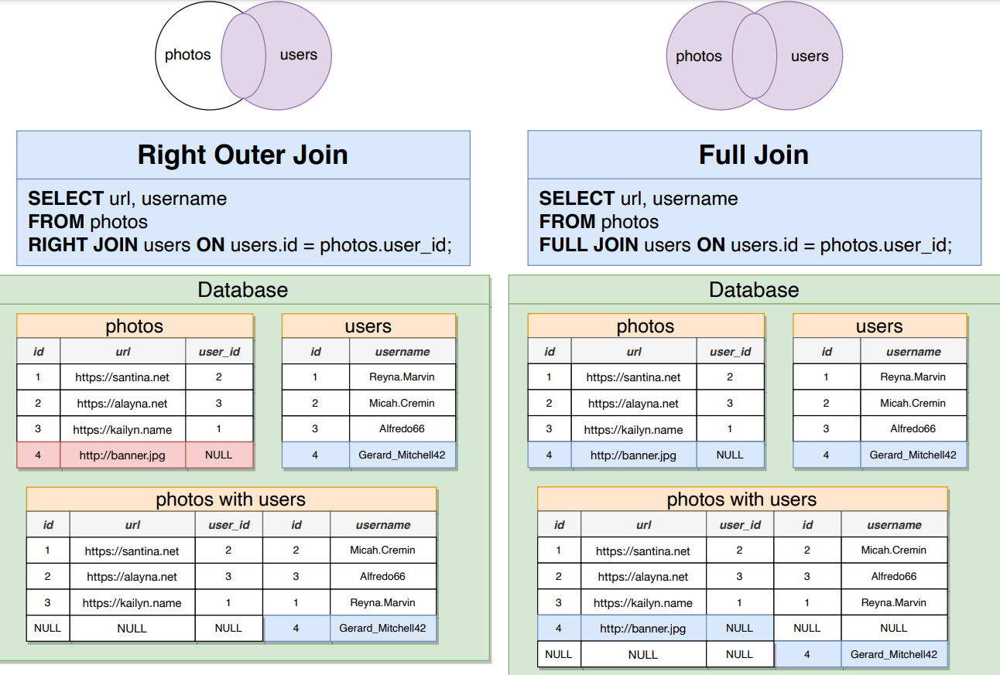

- **Inner Join/Join**: The keyword `JOIN` defaults to `INNER JOIN` - we can use either interchangeably. Automatically removes all rows where a match between the two tables was unsuccessful.

- **Left Outer Join**: Same as above but all rows from the `FROM` line will definitely be in the temporary table regardless of if a match was found. If a match wasn't found, then the `NULL` value fills in the remaining blanks.

- **Right Outer Join**: Opposite scenario to the above. All rows from the table following the `RIGHT JOIN` keyword will be in our final temporary table but not necessarily all rows following the `FROM` keyword. `NULL` values will fill in the blan ks.

- **Full Join**: Try to match as many rows as possible from the two tables. For all unmatched rows from **both** tables, include them in our final table but use `NULL` to fill in the blanks.

Going back to our scenario in the previous subsection, we can solve the problem by replacing `JOIN` with `LEFT JOIN`.

#### Another Example but using the `WHERE` keyword

Problem: Users can comment on photos that they posted. List the url (of the photo) and the contents for every photo/comment where this occured. In other words, who is commenting on their own photos? We want the **contents** (not the actual comment) where this occurred.

Let's take a look at the schema.

<img src=attachment:84d64499-c9c7-4dea-b0f1-f561a1d74e48.png width=600 />

We want all the urls and all the contents where the `user_id` of the comment matches the `user_id` of the photo. This means that the person who created the comment also created the photo. 

<img src=attachment:3a442e64-afef-4741-a28e-d2e2b00176d3.png width=600 />
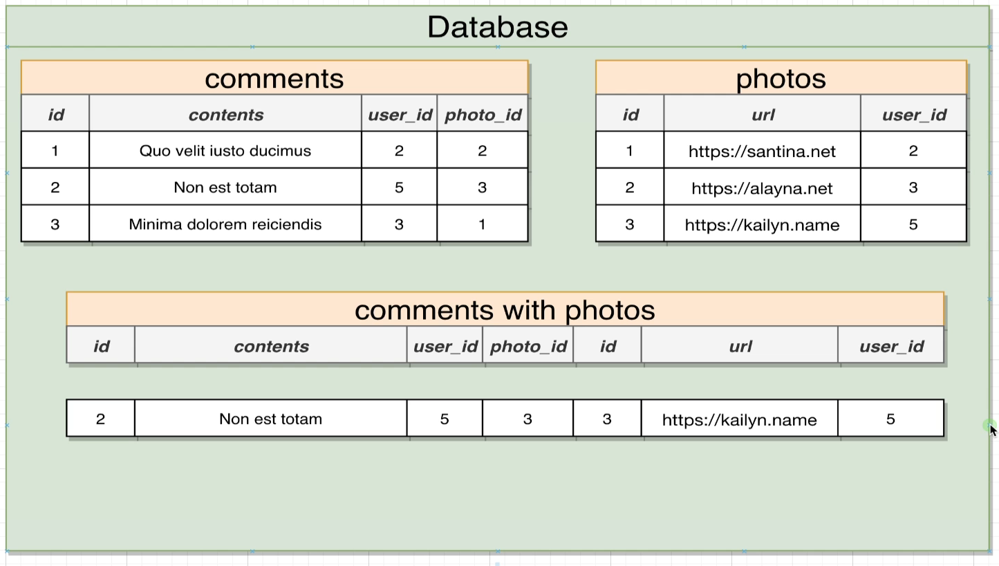
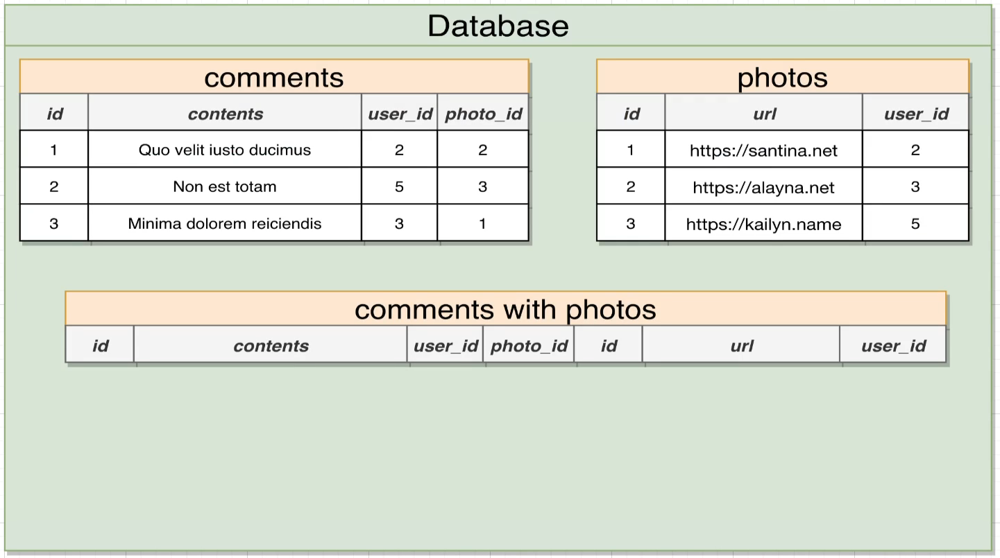

Here's the solution:

```
SELECT url, contents
FROM comments
JOIN photos ON photos.id = comments.photo_id
WHERE comments.user_id = photos.user_id;
```

#### Three Way Joins

So far so good - we have paired a column of urls with a column of contents where both data entries where created by the same user. But what if we wanted to find out the username of that user? The temporary table above does not contain a column of usernames because the `users` table is not mentioned after the `FROM` or `JOIN`, so we can't extract it by the `SELECT`. The solution is a three-way join.

What we're going to do first is the usual: join up comments with photos (`photo_id` of comment matches photo's `id`). This will iterate through all comments.

Then, we want to join our `users` column headings to this temporary table. But this joining will be on the condtion that **the `user_id` of the comment** = **the`user_id` of the photo** = **user's `id`**.

<img src=attachment:e3114738-9663-44cf-b8be-83ec486433d3.png width=600 />

But we don't want the rows contain `NULL` to appear in the final output. We can filter this out using `WHERE` but it's better if we use one of the `JOIN` types we've seen before. We're going to need an `INNER JOIN` because this only keeps rows where the equality holds true and disregards the remaining. 
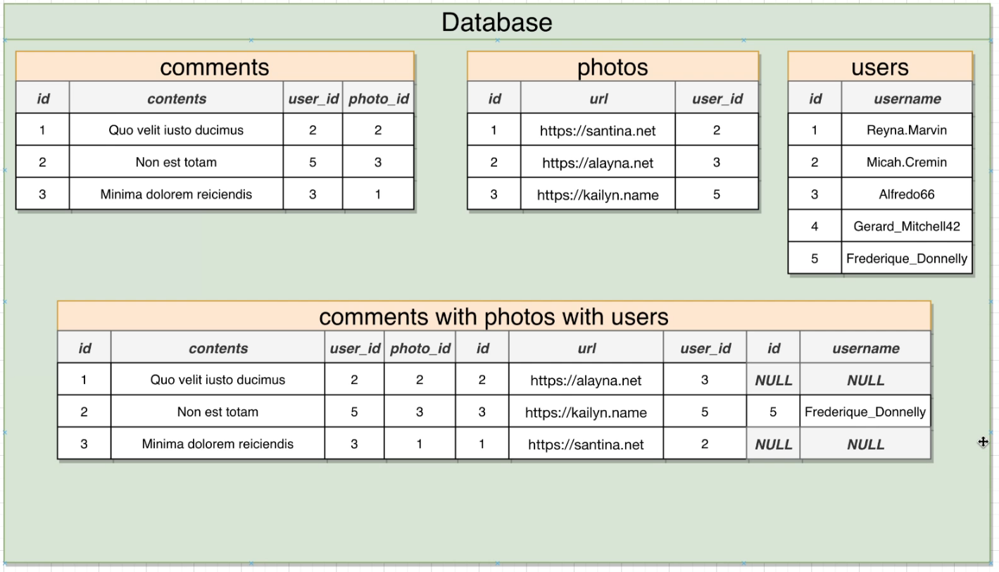

Here's the modified SQL query:

```
SELECT url, contents, username
FROM comments
JOIN photos ON photos.id = comments.photo_id
JOIN users ON comments.user_id = users.id AND photos.user_id = users.id
```

## Section 5

### Grouping

<img src=attachment:7493bb18-a583-4b6f-929d-ddb36b202c42.png width=500 />
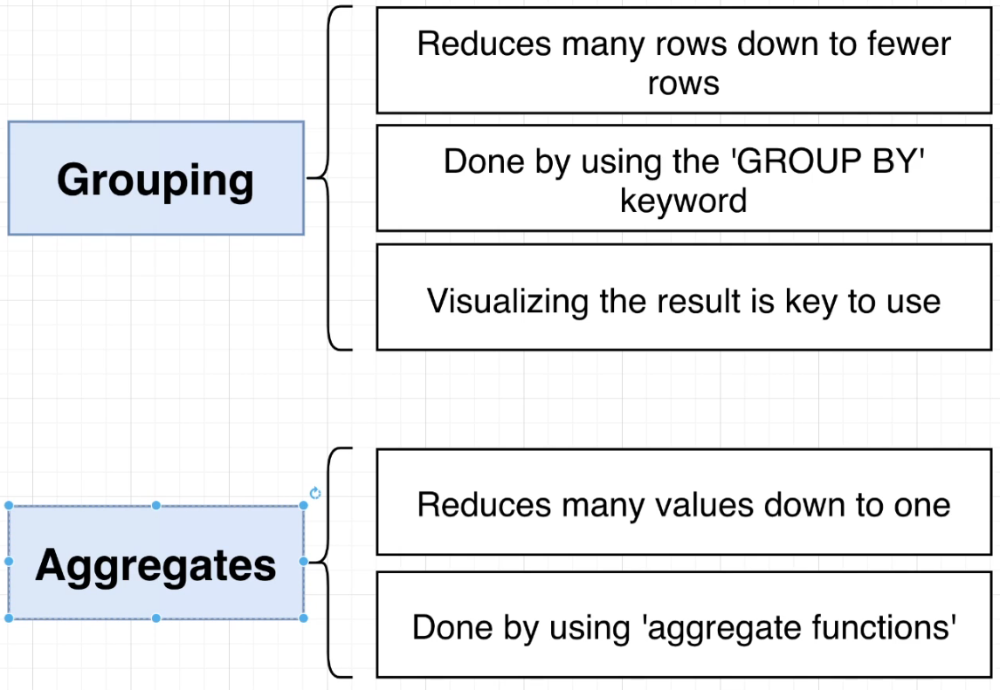

**`GROUP BY`**

Here's a SQL query:

```
SELECT user_id
FROM comments
GROUP BY user_id
```

output:\
`user_id`\
1\
2\
3\
4\
5

Now we have over 100 rows of data but we only returned 5 rows. SQL first selects all the rows from the `comments` table. Then, it finds the set of all unique `user_id`s. Afterwards, it groups together all `user_id`s that share the same value.

<img src=attachment:6c869369-2ba8-45d3-90c6-5a0d9168a73f.png width=600 />
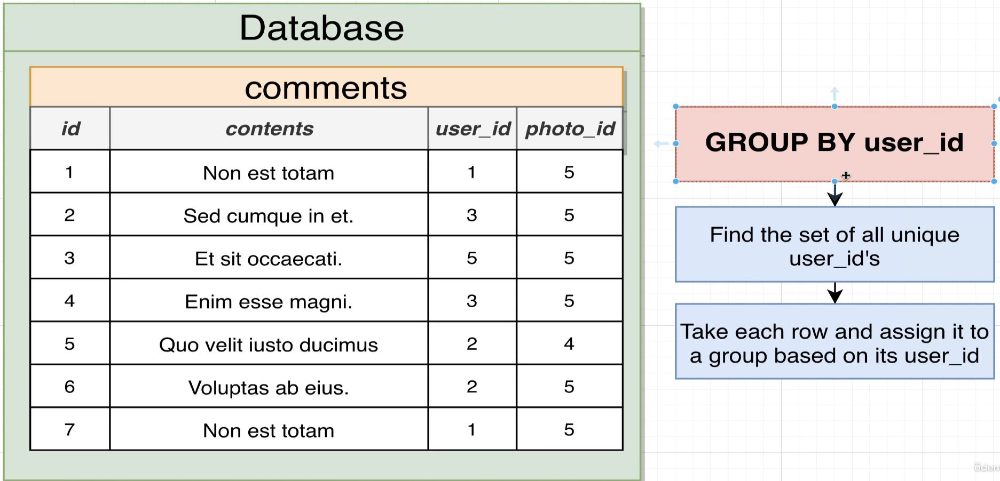

This is what our 'temporary' table looks like for a `GROUP BY` query.

<img src=attachment:769265d3-e867-462b-b35d-e08ee2d7382e.png width=500 />

**We can't select any column we want from a `GROUP BY` table. We can only select the `GROUPED` columns or some aggregate function. Therefore, we can't select any of the red columns in the image above.**
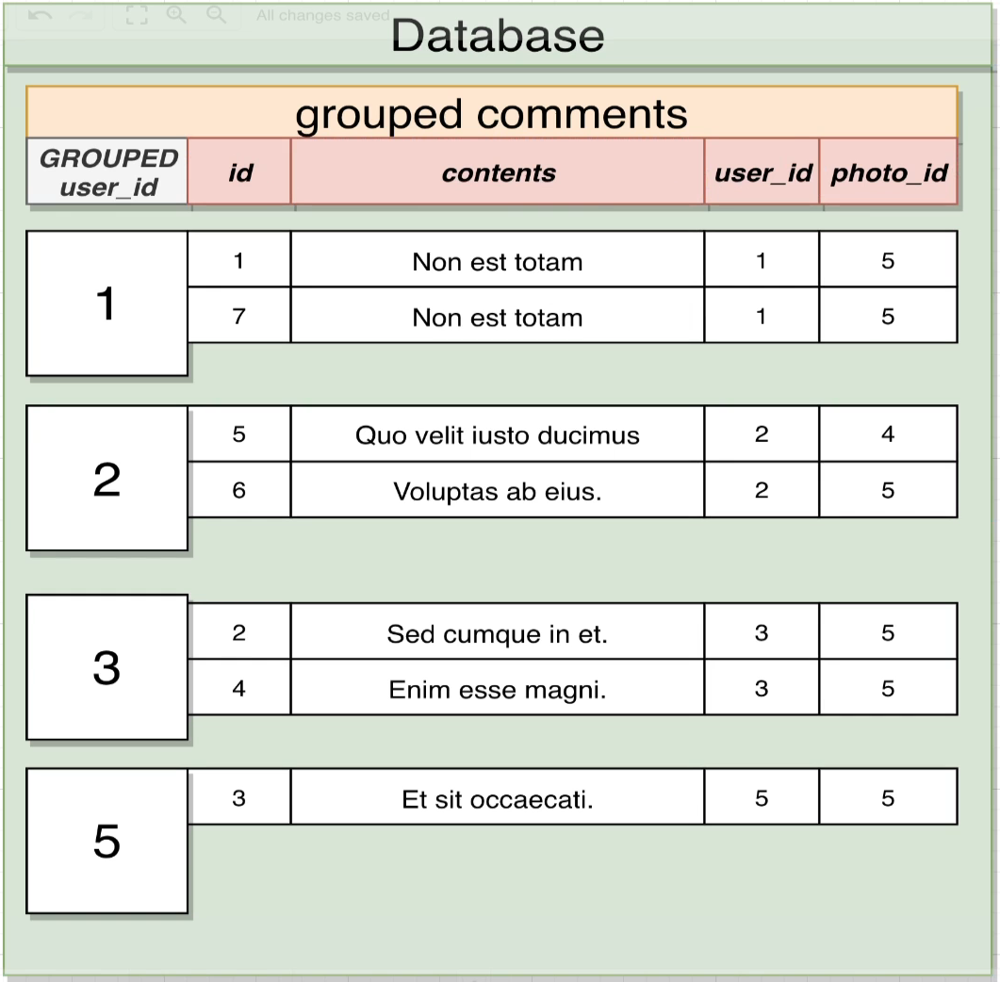

### Aggregating

The goal of aggregation is to reduce many different values down to one using 'aggregate' functions. Here are some common ones:

For a group of values we can find the: `SUM()`, `AVG()`, `MIN()`, `MAX()`, `COUNT()`.

**Examples**:

```
SELECT MAX(id)
FROM comments
``` 
\> max: 100

These functions simply take an entire column and compute one of these functions. Note that we cannot select a column in the regular way if we use one of these aggregate functions, so we can't do `SELECT SUM(id), id` and expect the `id` column to be presented alongside the single value.

### Combining Aggregates and `GROUP BY`

Take a look at the query:

```
SELECT user_id, MAX(id)
FROM comments
GROUP BY user_id;
```

Both selects are valid because `user_id` is a grouped column and `MAX(id)` is an aggregate. Here's what the temporary table looks like. 

<img src=attachment:17e80716-7311-4981-a786-761dc01d8c0e.png width=600 />

What's outputted is the `user_id` groups and the `max` id of each group. 

If instead we had `COUNT(id)` instead of `MAX(id)`, then we would find the number of IDs in each group. Semantically, this tells us the number of comments created by each user. For example, user with `user_id` = 1, has created 2 comments. This is really useful for any forum website. 

Note that `COUNT()` does not increment on `NULL` values. What if we wanted to get around that? 

We can use `COUNT(*)`: This counts **all** rows. It doesn't look at any column in particular.
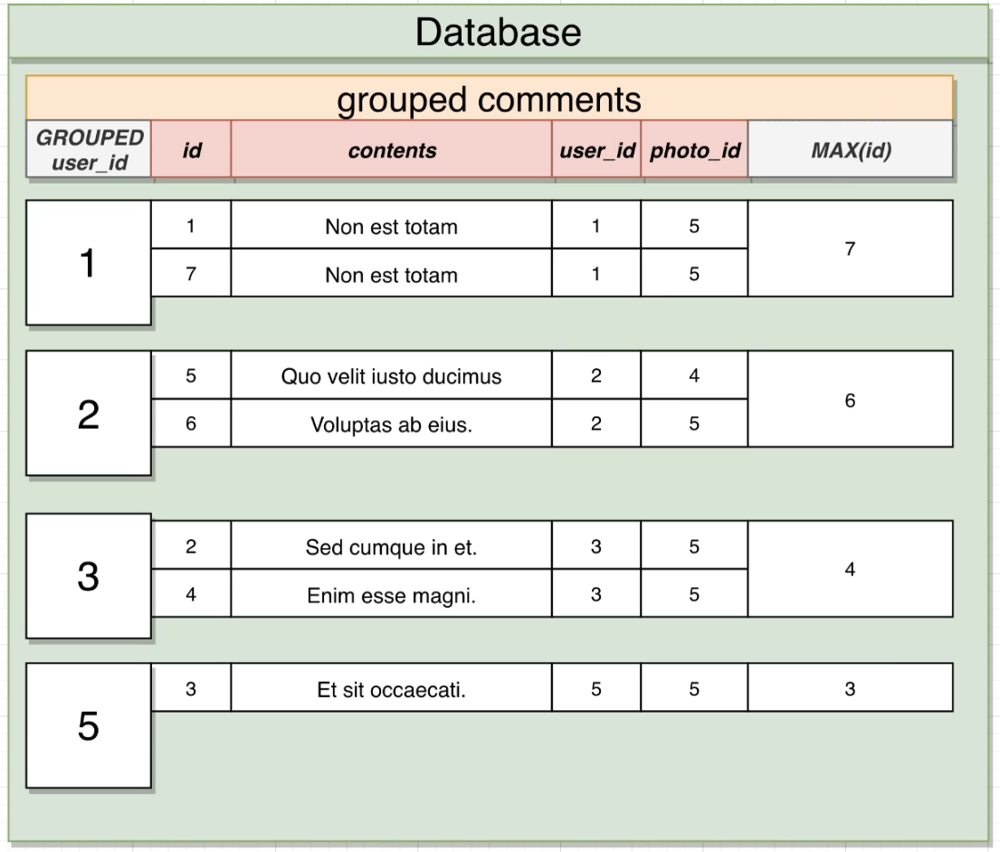

**One more example: Count number of comments for each photo**


```
SELECT photo_id, COUNT(*)
FROM comments
GROUP BY photo_id;
```

<img src=attachment:3d2f7051-55ea-496e-9a14-eb8b3d7c1256.png width=550 />
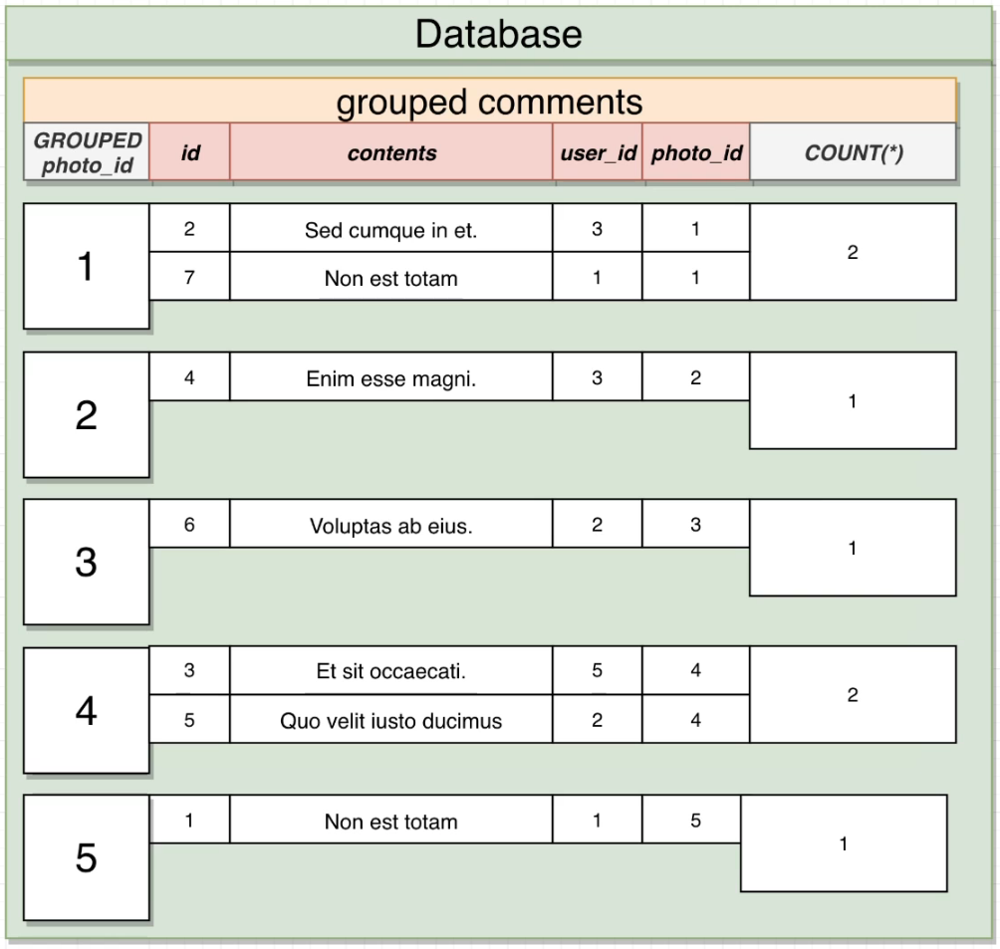

### Combining Aggregates, `GROUP BY` and `JOIN`.

**Example: Write a query that will print an author's name and the number of books they have authored.**


```

An example of the authors table
+----+-----------------+
| id | name            |
+----+-----------------+
| 1  | JK Rowling      |
+----+-----------------+
| 2  | Stephen King    |
+----+-----------------+
| 3  | Agatha Christie |
+----+-----------------+
| 4  | Dr Seuss        |
+----+-----------------+

An example of the books table
+----+---------------------+-----------+
| id | title               | author_id |
+----+---------------------+-----------+
| 1  | Chamber of Secrets  | 1         |
+----+---------------------+-----------+
| 2  | Prisoner of Azkaban | 1         |
+----+---------------------+-----------+
| 3  | The Dark Tower      | 2         |
+----+---------------------+-----------+
| 4  | Murder At the Links | 3         |
+----+---------------------+-----------+
| 5  | Affair at Styles    | 3         |
+----+---------------------+-----------+
| 6  | Cat in the Hat      | 4         |
+----+---------------------+-----------+
```

**Solution**

```
SELECT name, COUNT(*)
FROM books
JOIN authors on books.author_id = authors.id 
GROUP BY name;
```

Note that we can't use the `GROUP BY` before the `JOIN` because we want to select `NAME`, therefore, `NAME` must be in our temporary table. If `GROUP BY name` appears before the `JOIN`, we get an error because the `books` table doesn't contain any column titled `name`. We merge it into our temporary table using `JOIN`. Once merged, we can then group by it, and therefore, we can now select it (you cannot select non grouped columns).

### Having

We are starting to see the structure that our queries must be in:

<img src=attachment:16b6110c-2568-4bdd-a3c7-1621ee50a516.png width=450 />

`HAVING` is very similar to `WHERE` except we filter groups not rows. Therefore, you can't have `HAVING` without having a `GROUP BY`. The keyword `HAVING` almost always makes use of an aggregate function.
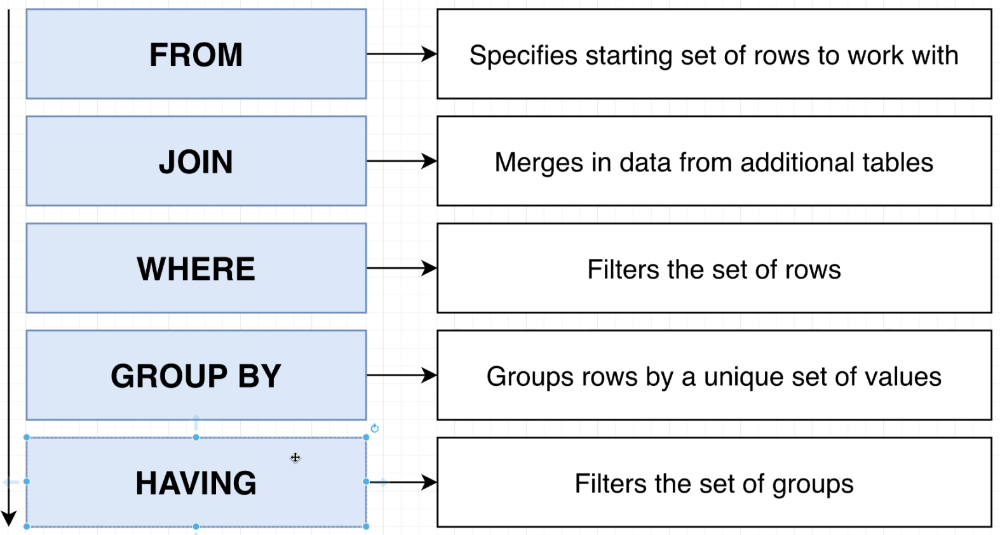

**Example: Find the number of comments for each photo where the `photo_id` is less than 3 and the photo has more than 2 comments**.

The first part of the problem is referring to filtering rows so we will need a `WHERE`. The second part refers to finding an aggregate value; in this case, a count of greater than 2 rows.

<img src=attachment:f0354142-aca9-4aea-9e1d-4aee0ad20299.png width=600 />

Steps:

1. Delete all rows with `photo_id` less than 3 (`WHERE'` step).
2. Group together all photos with the same id to fulfill 'for each photo' (`GROUP BY` step).
3. Count number of rows in each group (`COUNT(*)` step).
4. Filter out all groups that has 2 or less comments (`HAVING` step).

<img src=attachment:6e253d07-7eb0-4752-b6bd-0edfb41d3036.png width=400 />
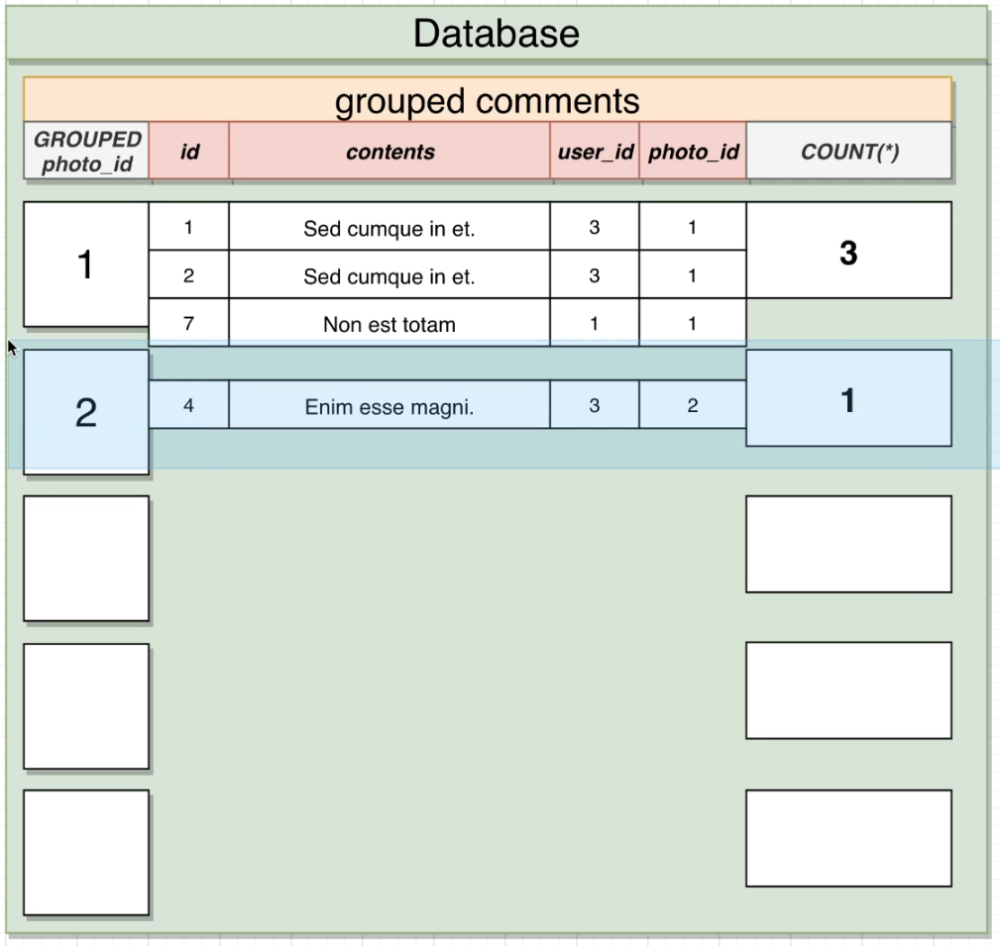
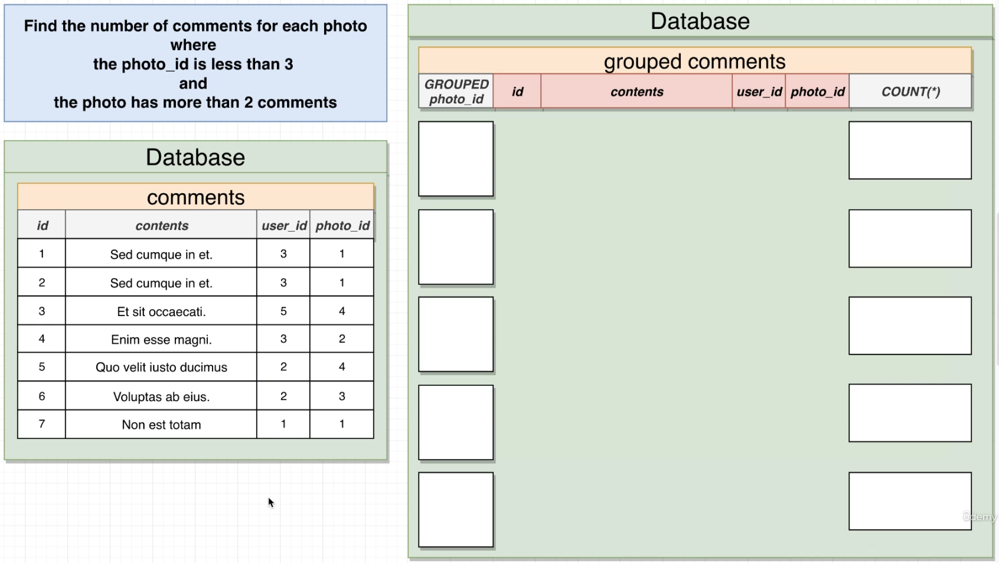

**Solution**

```
SELECT photo_id, COUNT(*)
FROM comments
WHERE photo_id < 3
GROUP BY photo_id
HAVING COUNT(*) > 2
```

## Section 6

For this section, we will use a dataset that can be found in the 'sql-files' folder outside of this notebook. The file is titled: 'section-6.sql'.

Below is the schema for this e-commerce application:

<img src=attachment:0b8071b9-ecda-49ab-b0b5-fa0bc5887b8b.png width=700 />

The relationship between users and products is many-to-many. We model this relationship using the `orders` table. This is referred to as **join table**. This is basically a review section. Go to videos for some exercises.
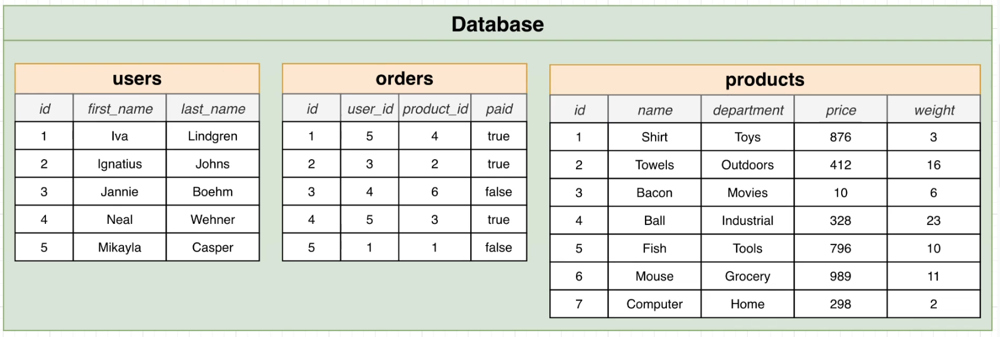

## Section 7

Sorting is very simple. We use the keyword `ORDER BY`, and it works intuitively.

```
SELECT * 
FROM products 
ORDER BY price;
```

-> Produces all data in table organised from smallest to largest in the `price` column. We can modify the last line to `ORDER BY price DESC;` to reverse the order to descending.

If we sort on characters instead of integers, it'll sort them alphabetically.

We can sort by multiple columns too such as price AND weight. After sorting the price, if there are two rows with the same price but different weights, we can shuffle the rows so that the smallest weight appears first. 

For example:

<img src=attachment:33aa80cf-4d91-4213-a706-920d145cb325.png width=500 />

To do this, our SQL query becomes:

```
SELECT * 
FROM products 
ORDER BY price, weight;
```
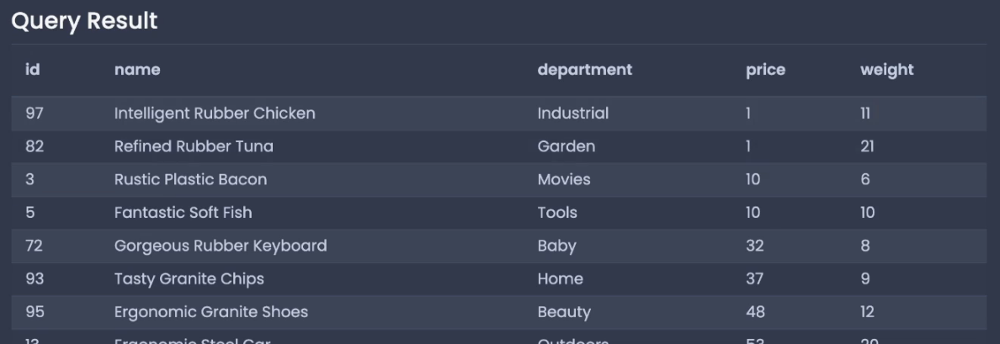

### `OFFSET` and `LIMIT`

If we select all the rows of some data, the `OFFSET` keyword will skip the first x rows from our selection.

`LIMIT` limits the amount of rows that we want to see in the selection. So `LIMIT 2` will ensure that there are only 2 rows in our selection. 

For example, if we had 50 users and we only want to see from the 40th onwards, and only 2 rows in total, we would write:

```
SELECT *
FROM users
LIMIT 2
OFFSET 40
```

The order of `LIMIT` and `OFFSET` is unimportant. 

## Section 8

### Unions and Intersections

(see a couple more cells down for the different set operators)

Take a look at the problem below.

<img src=attachment:de2693ab-305f-4ba4-a176-3fd336d279f9.png width=600 />
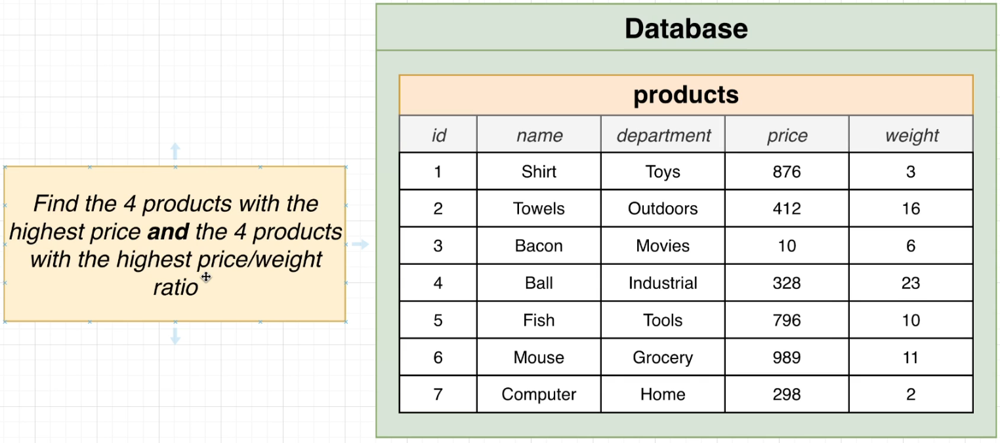

It will be challenging to write a single query to solve this. That's because the statement has two very different sorting criteria. To get started, let's try to write a query to solve each problem separately.

Find the 4 products with the highest price:

```
SELECT *
FROM products
ORDER BY price DESC
LIMIT 4
```

Find the 4 products with the highest price/weight ratio:

```
SELECT *
FROM products
ORDER BY price / weight DESC
LIMIT 4
```

To union the two queries, all we do is remove any semi-colons, wrap the two statements in parenthesis, add `UNION` between the two, and end the entire query with a semi-colon:

```
(
    SELECT *
    FROM products
    ORDER BY price / weight DESC
    LIMIT 4

)
UNION
(
    SELECT *
    FROM products
    ORDER BY price DESC
    LIMIT 4
);
```

Note: 

- If a row satisfies both queries, it will only appear once in the final output. But we can work around this using the `ALL` keyword after `UNION`.
- We strictly don't need the parenthesis but it makes the statement much clearer and less error-prone.
- We can only perform `UNION` if the output of the individual queries have the same columns (same `SELECT`s). If the columns are made to have the same name, through renaming for example, it still won't work if the datatypes are different.

Here are all the set operators:

<img src=attachment:0e4635bd-cf47-40a4-99cb-1aaf18244d13.png width=500 />
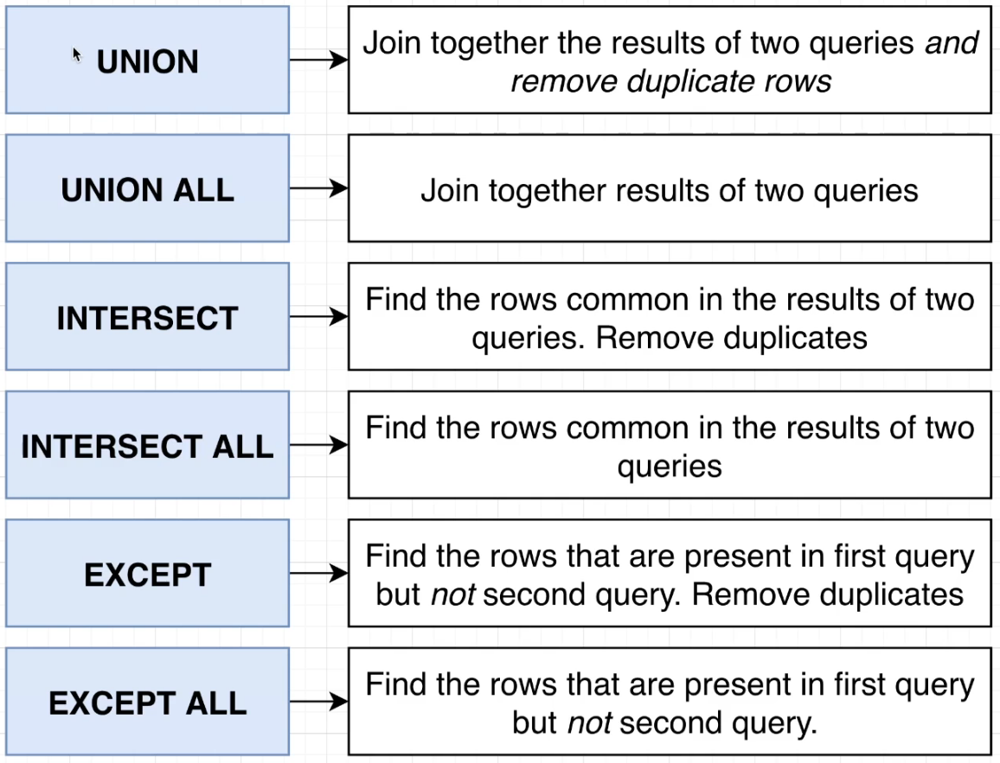

They all work intuitively. But note that for `EXCEPT`, the order of the queries *does* matter. If query 1 appears on the left of `EXCEPT` while query 2 appears on the right, then, query 1 will only contain unique rows with respect to query 2. In other words, the rows in query 1 will not be present in query 2.

## Section 9

### Subqueries

A subquery is basically a query, enclosed in parentheses, that exists as part of a larger query.

Let's pose a problem.

<img src=attachment:97ed63f8-d770-4ebd-97cc-37a6bee6eccb.png width=700 />

We first want to consider only the rows that have department: 'Toys', and then find the highest price of them. Next, we want to look throughout our entire table and find all rows with a price higher than this amount.
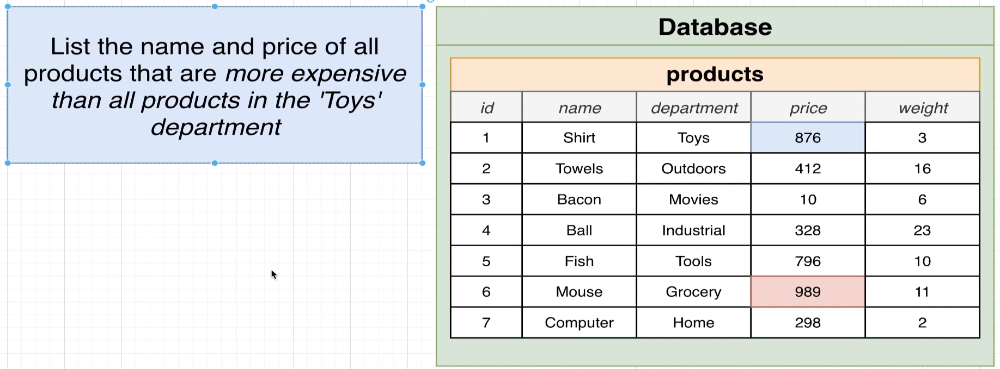

Here's a good way of laying it out:

<img src=attachment:db821bae-b0f9-45e2-8c45-33d0cab594d2.png width=350 />
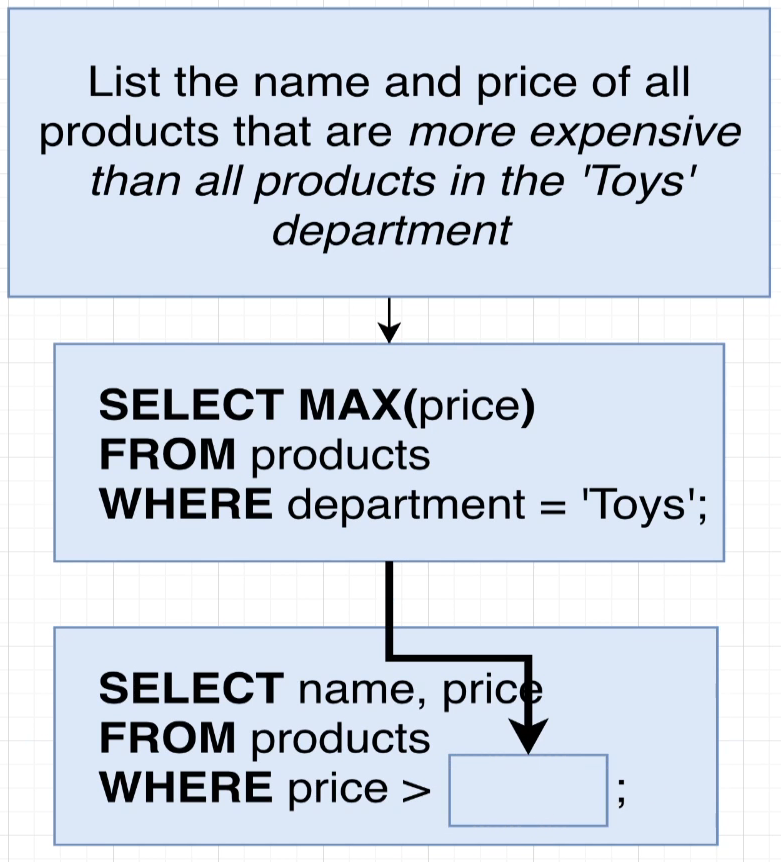

To write a subquery, we first start with the last *incomplete* query and then use parenthesis to demarcate the subquery:

```
SELECT name, price
FROM products
WHERE price > (
    SELECT MAX(price)
    FROM products
    WHERE department = 'Toys'
);
```
The second query will be executed first by postgres. It may also be better to write it out on one line afterwards:

```
SELECT name, price
FROM products
WHERE price > (
    SELECT MAX(price) FROM products WHERE department = 'Toys'
);
```

A query can contain many subqueries, but it's important that the output data of each subquery is of the correct shape.

<img src=attachment:91d98d8a-b68a-4ca4-b13e-105717281d4a.png width=600 />
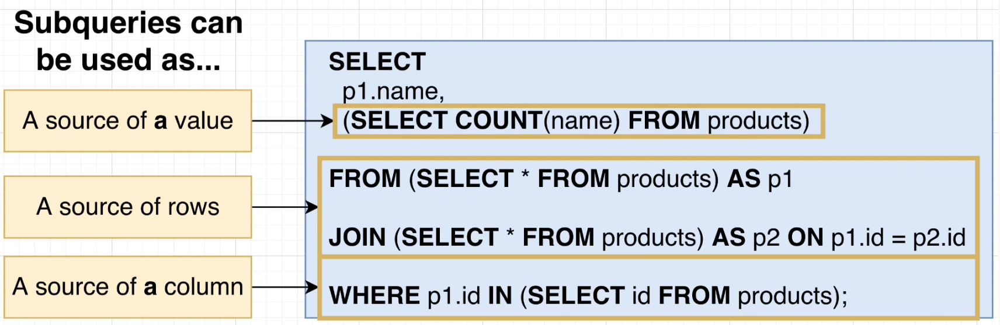

Whenever we get a single value (exactly 1 single row with 1 single column) back from a subquery, it is known as a **scalar query**. 

Let's break down the above into using subqueries for `SELECT`, `FROM`, `JOIN` and `WHERE`.

#### Subqueries in a `SELECT`

<img src=attachment:2574d97a-5682-499e-87f8-0a5b72dbf557.png width=700 />
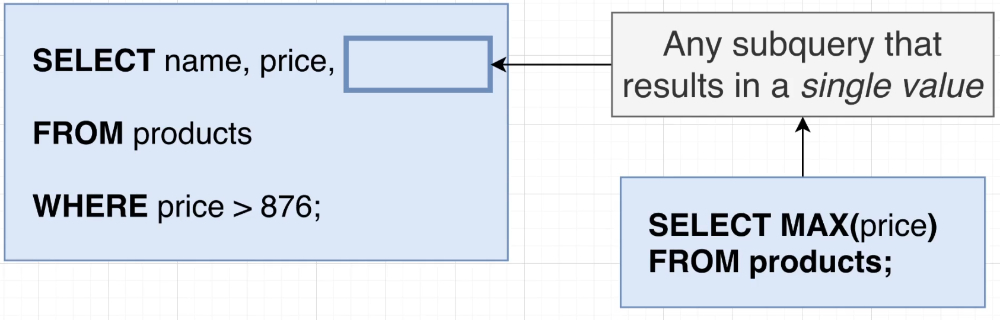

#### Subqueries in a `FROM`

Before we can insert a subquery into a `FROM` we need to ensure that it's compatible as a source of data for the rest of our outer queries.

<img src=attachment:482ac8ad-ad71-4734-be4f-a5caa2ac36e7.png width=600 />

So, we should first compute the subquery and then see if the rest of our outer query can apply to this new source of data. 

**Gotcha: We must use an alias to the _result_ of our subquery: `FROM (<subquery>) AS <alias>`. We're not referring to the `AS` that's in the subquery; rather, the result of it.**

The `SELECT` now applies to our new source of data. So, since our new data has a `price_weight_ratio`, we can use that in our outer `SELECT` query. 

We can also apply a `WHERE` to it, as it it were native to our original query, e.g. `WHERE price_weight_ratio > 5`. 

But this cuts both ways; if we originally had a column that was excluded in our subquery's `SELECT`, then, we won't be able to include it in our main query's `SELECT`.
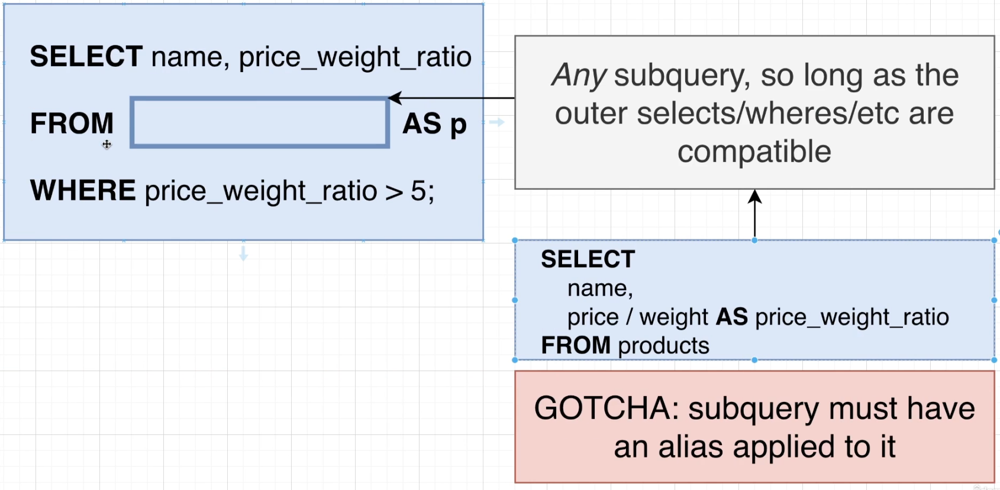

**Realistic Example (but there are easier ways than this):** Let's say we have a bunch of orders from a bunch of users. We want to find the average number of orders over all users. A subquery will be very useful here.

We could first use `GROUP BY` on `user_id` so that we have buckets for each user which contains the products they've bought. If we apply `COUNT(*)` to each bucket and then use `AVG` on this single column for our final answer.

<img src=attachment:56073ef6-9b74-4c91-8a62-16bfa279b526.png width=400 />


```
SELECT user_id, COUNT(*)
FROM orders
GROUP BY user_id
```

Once we've got to this point, we'd ideally want to use the `COUNT(*)` column as input data that we can sum over. This is where subqueries are useful. Let's select this `COUNT(*)` column but first we'll rename it to `order_count`.

```
SELECT p.order_count
FROM (
    SELECT user_id, COUNT(*)
    FROM orders
    GROUP BY user_id
) as p
```

**Remember that once we use an alias, we have to use it throughout our query.**

Now we need to use an aggregate `AVG()` function and then we're done.

```
SELECT AVG(p.order_count)
FROM (
    SELECT user_id, COUNT(*)
    FROM orders
    GROUP BY user_id
) as p
```

Note that since the column had integer data type, our final result will always be rounded to an integer even if it is a float.
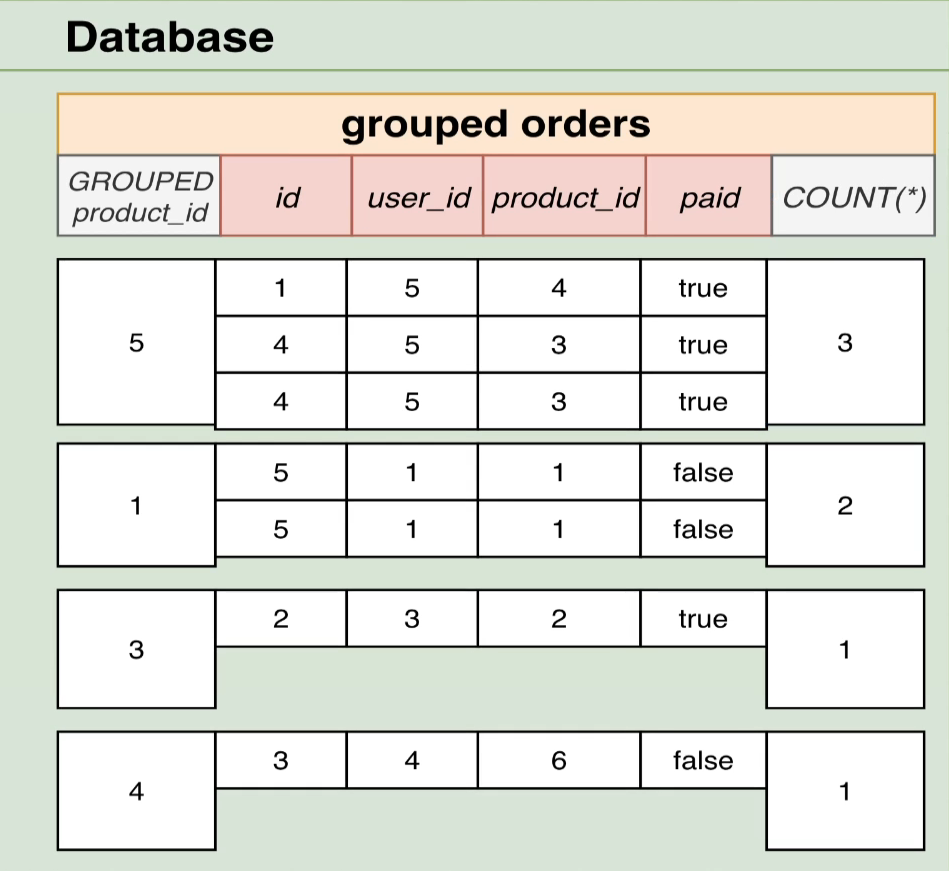

#### Subqueries in a `JOIN`

The rule for this type is that we can put any data in the `JOIN` clause so long as it's compatible with the `ON` clause. Let's try to find all the users who purchased a particular product, and then find the first name of those people.

Taking a look at the subquery first; this will return (in this case) a single column with a single row, corresponding to `user_id = 5` who is the only one to purchase `product_id = 3`. Note that this technically is a table (with only 1 column and 1 row) so we can use a `JOIN` on it.

<img src=attachment:a72ff250-d1bc-485d-b22f-0df22ef77252.png width=700 />

We now have two tables: `users` and `orders`. We can match the `id` in the `users` to the `user_id` in the `orders` table with a `JOIN`, and then select the first name:

<img src=attachment:8a7c4b81-77eb-4000-86d8-1453c055506e.png width=700 />

**Solution:**

```
SELECT first_name
FROM users
JOIN (
    SELECT user_id FROM orders WHERE product_id = 3
    ) as o
ON o.user_id = users.id;    
```
 
Note that, in this scenario, it wouldn't be appropriate to do it this way - we could just do `JOIN` on `orders` as opposed to a subquery and filter using a `WHERE orders.product_id = 3`, and we'll get the same result.
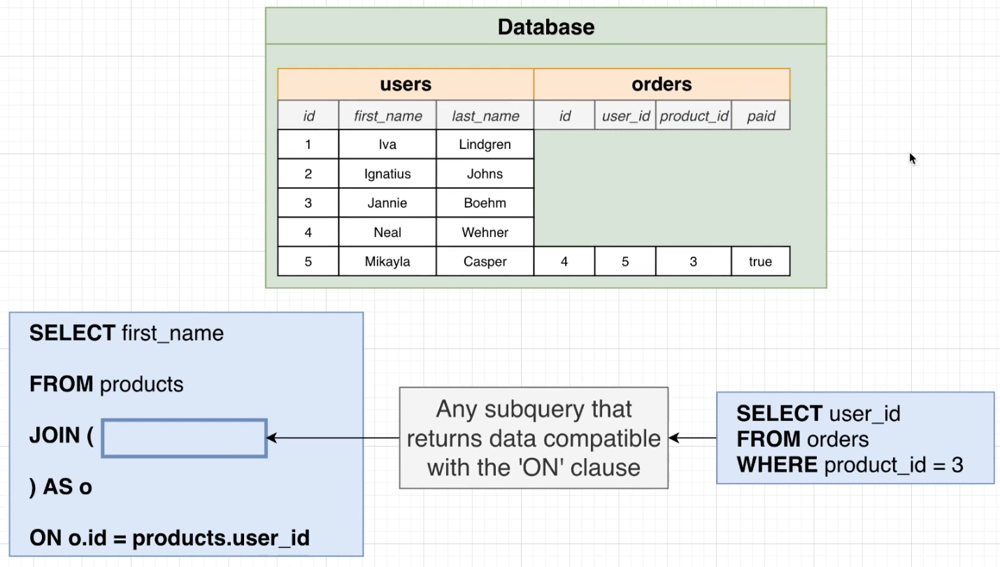
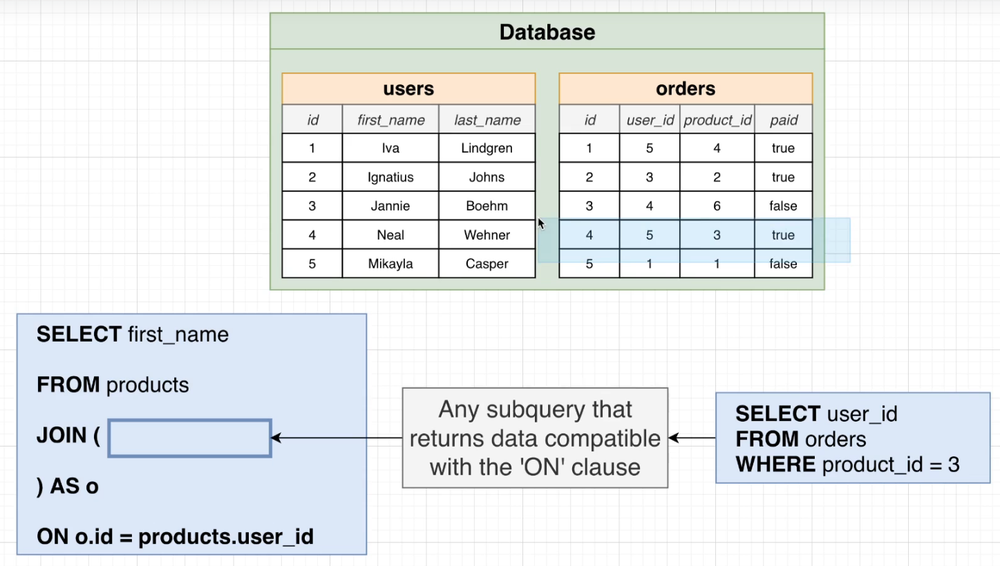

#### Subqueries in a `WHERE`

This is where you'll see subqueries used the most. Also, you'll notice that `WHERE` clauses can often be interchanged with `JOIN` clauses - there are benefits to either approach, but usually `WHERE` clauses are more intuitive to read and understand.

**Example: Show the ID of ortders that involve a product with a price/weight ratio greater than 5**

<img src=attachment:45751ad9-b8b7-463c-92cd-c50cf72efb49.png width=700 />
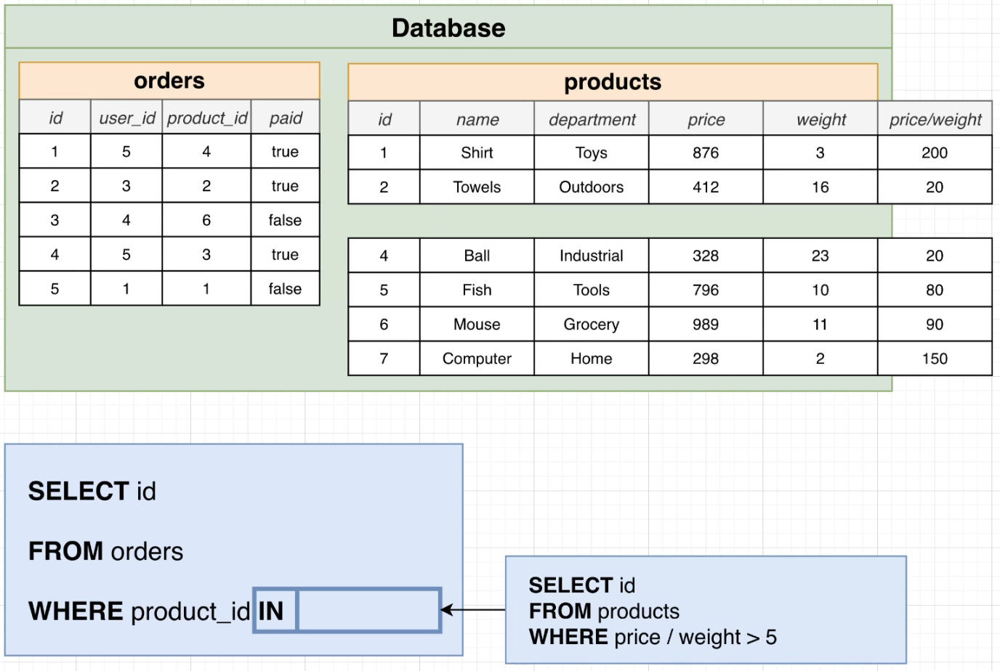

We can now select just the `id` column and move onto the main query.

All we do here is see if the `product_id` value for each row in the `orders` table exists in the `products` table. Below, only the highlighted `product_id` value of '3' is not in the `products` table, so we remove it.

This is our final answer:

<img src=attachment:bd3a2c3e-cc3e-46df-889c-4250dac5e636.png width=300 />

```
SELECT id
FROM orders
WHERE product_id IN (
    SELECT id FROM products WHERE price / weight > 50
);
```
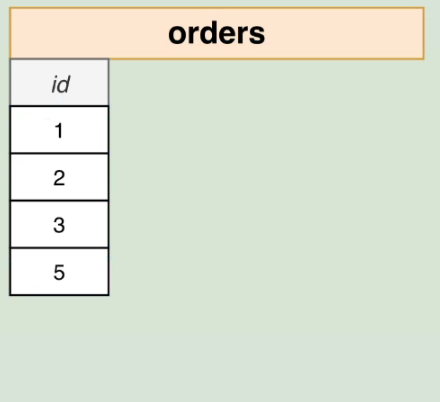

### `ALL` and `SOME/ANY` operators 

**`ALL`**

These are new operators that can be used in `WHERE` statements to simplify queries. Let's take a look at an example:

**Example: Show the name, department, and price of products that are more expensive than all products in the 'Industrial' department.**

We may wish to first find the maximum price of products from the 'Industrial' department and use that as a subquery to filter the original dataset. Like so:

<img src=attachment:ebc71c7a-821a-4f3f-bad0-469073cd8bdc.png width=600 />

**But there's another way. We can use the `ALL` keyword to find the rows that have a price greater than `ALL` industrial products:**

```
SELECT name, department, price
FROM products
WHERE price > ALL (
    SELECT price FROM products WHERE department = 'Industrial'
);
```

<img src=attachment:b5f0d61b-dbf4-496c-a3e2-9a43394325c4.png width=600 />
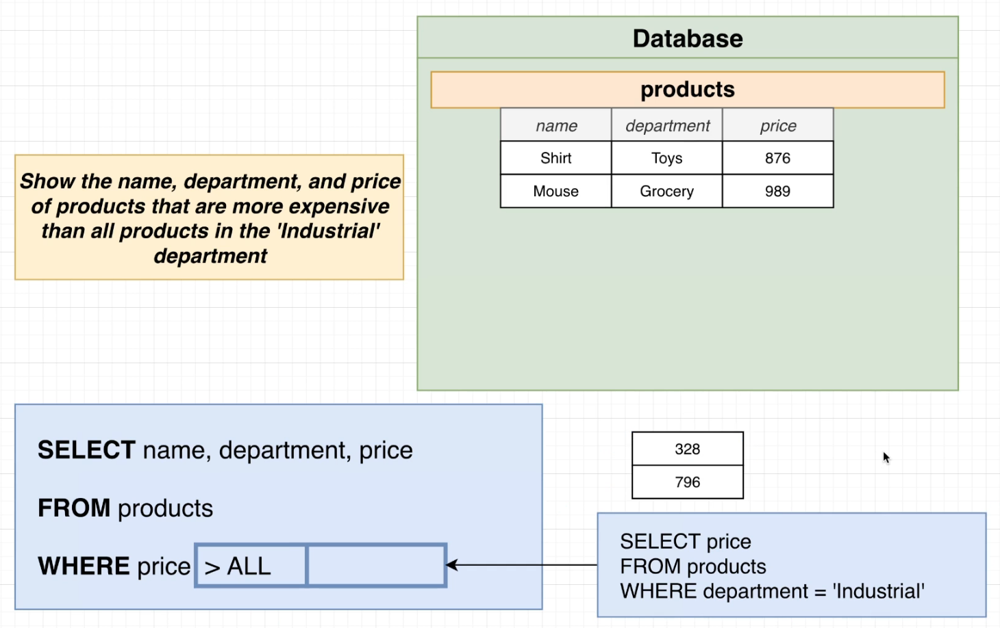
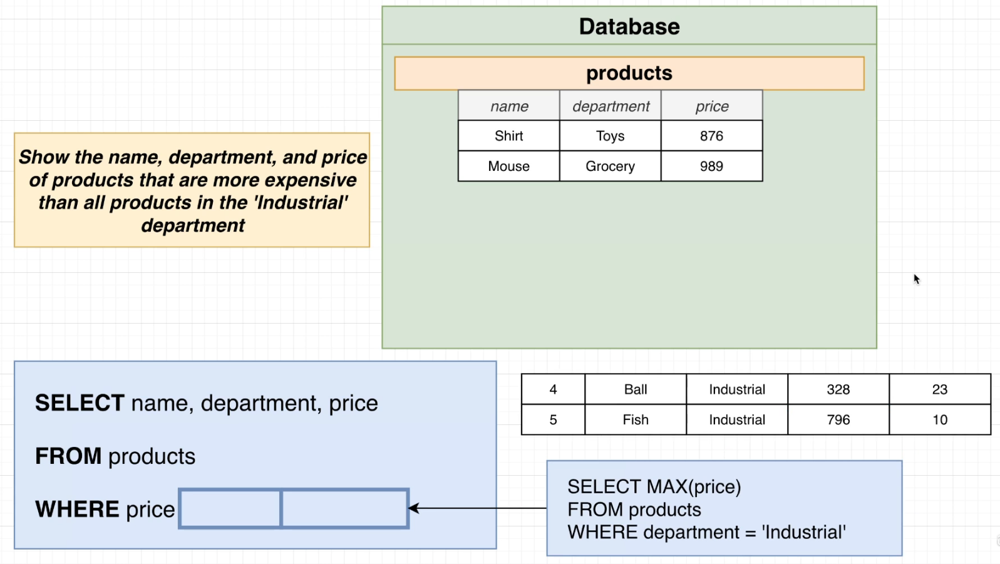

**`SOME`** 

This is identical to the above, but instead of keeping the rows that have a price greater than `ALL` industrial products, we only need the price to be greater than **at least one** of the industrial products.


```
SELECT name, department, price
FROM products
WHERE price > SOME (
    SELECT price FROM products WHERE department = 'Industrial'
);
```

### Correlated Subqueries

There's a few concepts to take onboard for this subsection. Let's introduce a problem:

**Example: Show the name, department, and price of the most expensive product in each department**

<img src=attachment:b826e5ee-4a95-4526-ad55-573278fb4af1.png width=700 />


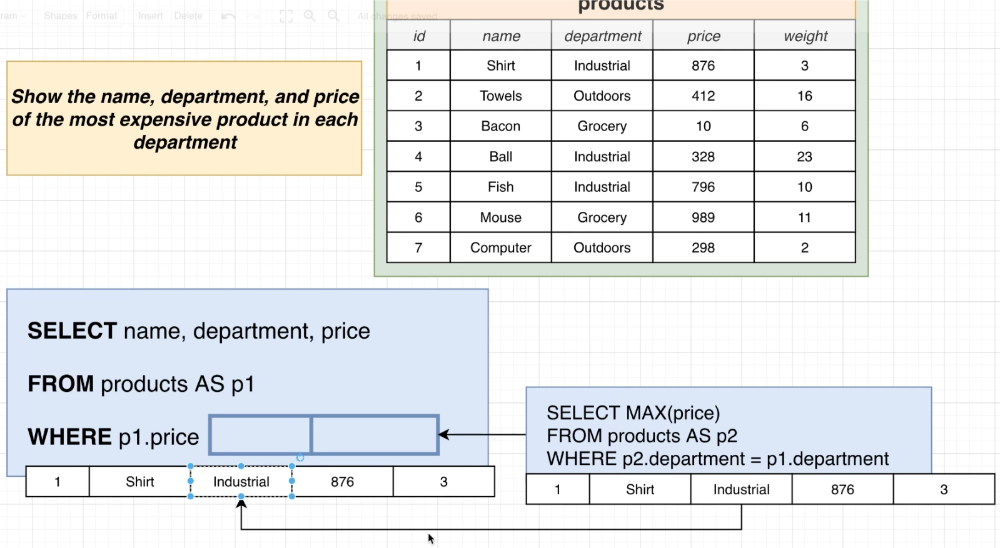

We'll break down the image above, bit by bit.

1. We may think towards using a `GROUP BY` approach here, but we'll try something different. Firstly, consider the following subquery:

```
SELECT MAX(price)
FROM products AS p2
WHERE p2.department = 'Industrial'
```

The first thing to note is that, in order to compute this subquery, postgres will need to iterate through the entire table, and therefore have a big O complexity of O(n). The resulting output of this subquery is a single row corresponding to the industrial product with the largest price.

2. But 'Industrial' has been hardcoded in; we may have found the right row for this department, but we want to repeat it for all department types. To find a general form, let's go back to the main query. Here, we have a very similar query structure

```
SELECT name, department, price
FROM products AS p1
WHERE p1.price <operator> <subquery>
```

This, too, must iterate through all rows in the `products` table. For each row that it iterates through, the subquery will be executed, which itself iterates through the entire table. This is basically a nested 'for' loop, and thus, our time complexity goes to O(n^2).

For the first iteration of the main query, we take the first row in the table and focus on the price value of this row: '876'.

3. Now, going back to the subquery, let's generalise the department. Instead of 'Industrial', we can use `p1.department`, so our line becomes `WHERE p2.department = p1.department`. Why? Because the outer query's 'for' loop starts its iteration on the first row; if we get a handle on that department using `p1.department` (remember `p1` refers to all things in the outer 'for' loop), then, in the nested for loop, we can iterate through all rows and keep only those rows that have a matching department. In this case, we start with the 'Industrial' department. 

**Note that this method allows us to refer to rows in our subquery _from our main query_ (and we must use aliases for this); this is what defines correlated subqueries.**

After all iterations of the nested loop are complete, we have 3 remaining rows; they will all be from the 'Industrial' department because the main query is still on the first row. The final thing to do for the nested query is `SELECT MAX(price)` which reduces our rows down to 1 **value** -> '876'.

4. This step is going to allow us to move on to the next iteration in our main query. To do this, we're going to use a 'conditional' which in postgres is just the `WHERE` statement. Again, since we only want to keep the row with the largest price value, which we found as '876', we can just use an equality. Evaluating the first iteration of the main query explicitly, we get:

```
SELECT name, department, price
FROM products AS p1
WHERE p1.price (i.e. 876) = '876'
```

Recalling that the main query's `WHERE` is still on the first row in its iteration process, we find that the price does match. We are now certain that this first row has the highest price for its given department. Let's move onto the 2nd iteration of the main query.

5. Our 2nd iteration is concerned with the 'Towels' product from the 'Outdoors' department. The subquery 'for' loop will loop over **all** rows then extract two rows with id 2 and 7. It turns out the `id = 2` has the highest price of 412, so it will be kept. Explicitly evaluating the 2nd iteration of the main query, we get:

```
SELECT name, department, price
FROM products AS p1
WHERE p1.price (i.e. '412') = '412'
```

so this row too will be kept.

6. Skipping ahead to the 4th iteration in the main query, we see we're back at an 'Industrial' product. But this time, the main query evaluates to:

```
SELECT name, department, price
FROM products AS p1
WHERE p1.price (i.e. '328') = '876'
```

this will evaluate to False and therefore, row 4 will be discarded - this is what we want. Our goal was to find the name, department, and price of the most expensive product in each department. Our first department, 'Industrial', has been evaluated, leaving only 1 row. The next iteration of the main query produces 1 more row ('Towels' with id 2). Since the 3rd iteration is concerned with another unique department, we're able to extract the 3rd row. The remaining 4 iterations of the main query are redundant as we've already found the max price for our 3 unique departments, but postgres doesn't know this and will execute them - of course, from postgres' perspective, there could be another unique department in the final row.

Another example but with the correlated subquery within the `SELECT` of the main query as opposed to the `WHERE` can be found in the full course (Video 114).

Note that, if you use a subquery (correlated or not) within the `SELECT` of the main query, you don't necessarily need a `FROM`, `JOIN`, `WHERE` etc. in the main query. This only works if the subquery returns 1 single value (scalar query). For example,

```
SELECT (
    SELECT MAX(price) FROM products
)
```

This is useful if you need to perform one quick calculation. For example, if you wanted to calculated the ratio of the most expensive to least expensive product, you could write:


```SELECT (SELECT MAX(price) FROM products) / (SELECT MIN(price) FROM products);```
    

But note that, if you have multiple subqueries, each returning one single value, you can effectively build up one long row. For example:

```
SELECT (SELECT MAX(price) FROM products), 
       (SELECT MIN(price) FROM products), 
       (SELECT AVG(price) FROM products);
```

## Section 10

This section and the next contains miscellaneous concepts and keywords that don't easily fit into the other topics.

### `DISTINCT` keyword

We use this keyword to extract distinct values. If we have a table of products with items belonging to many departments and we want to return a list of **only the unique departments**, we can use `SELECT DISTINCT department`. We can pair this with `COUNT` to find the number of unique departments: `SELECT COUNT(DISTINCT department)`

We could also have multiple comma-separated columns after `DISTINCT`; this will produce duplicates within each column, but each row, taken as a whole, will be unique. For example, in the image below, two products are from the same department ('kids') but have different names ('Handcrafted Cotton Bacon' and 'Handcrafted Soft Chicken', respectively). Therefore, these rows are unique.

<img src=attachment:3d3ccad2-18a1-4cac-8c78-3749e95d7666.png width=350 />

Note that we won't be able to return any value associated to that unique department, such as name, price, weight etc. 
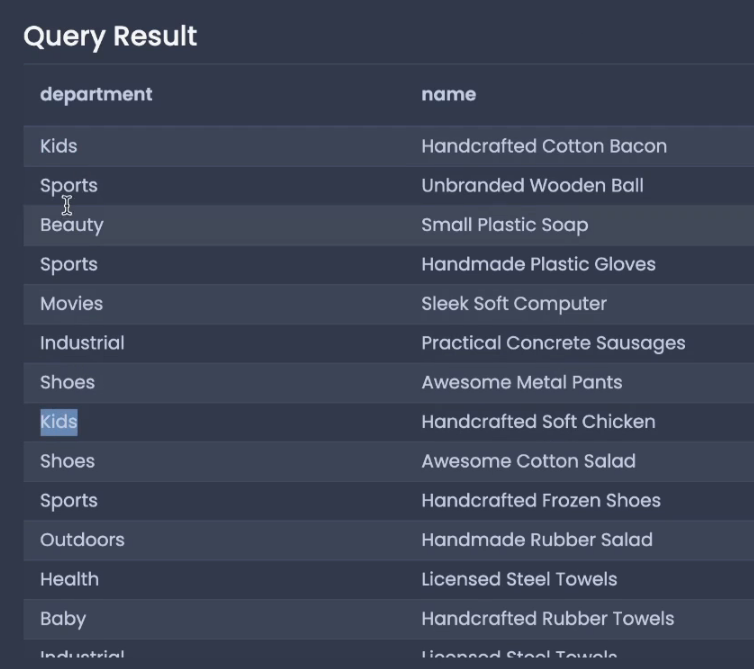

## Section 11

### `GREATEST` and `LEAST`

Postgres has a function that allows you to select the greatest or least value from a list of arguments.

`SELECT GREATEST(200, 10, 30);`

When would this come in handy? Let's say we want to calculate the shipping of some product. Our rule is to take the max(£30, 2 * weight).

<img src=attachment:612acf5d-3801-4793-8d11-72aaa6da4bef.png width=500 />

To generate the final column in postgres, we'd write:

`SELECT name, weight, GREATEST(30, 2 * weight)`

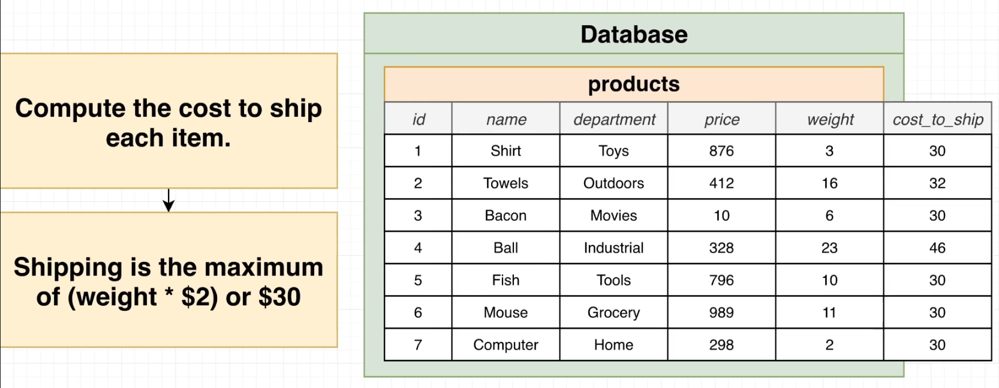

We can find the least value out of a list of arguments using `LEAST` in the same way.

### `CASE` keyword

Consider the following problem:

<img src=attachment:95489acc-2876-4972-ad8a-c556444a1bde.png width=550 />
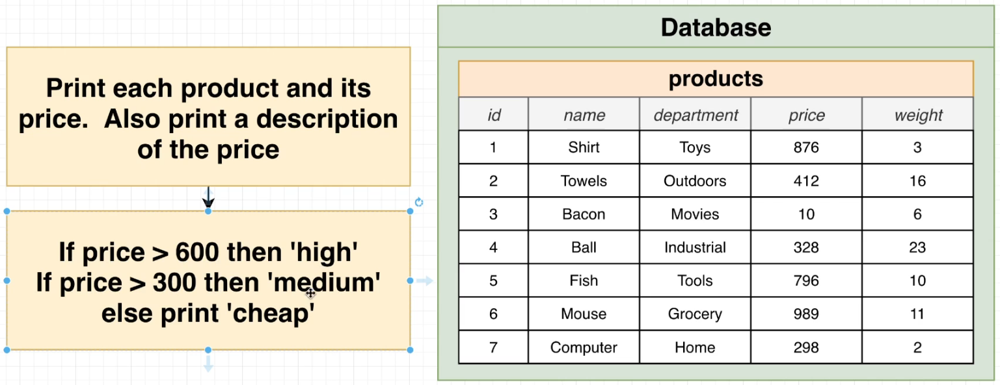

Here's how to do it:

<img src=attachment:24f1ced6-f3a7-4df2-ad1a-c2a35f8fb468.png width=550 />

It works similar to a switch statement in javascript. 

Note that you won't be using this keyword much as this step is normally computed elsewhere in the stack.
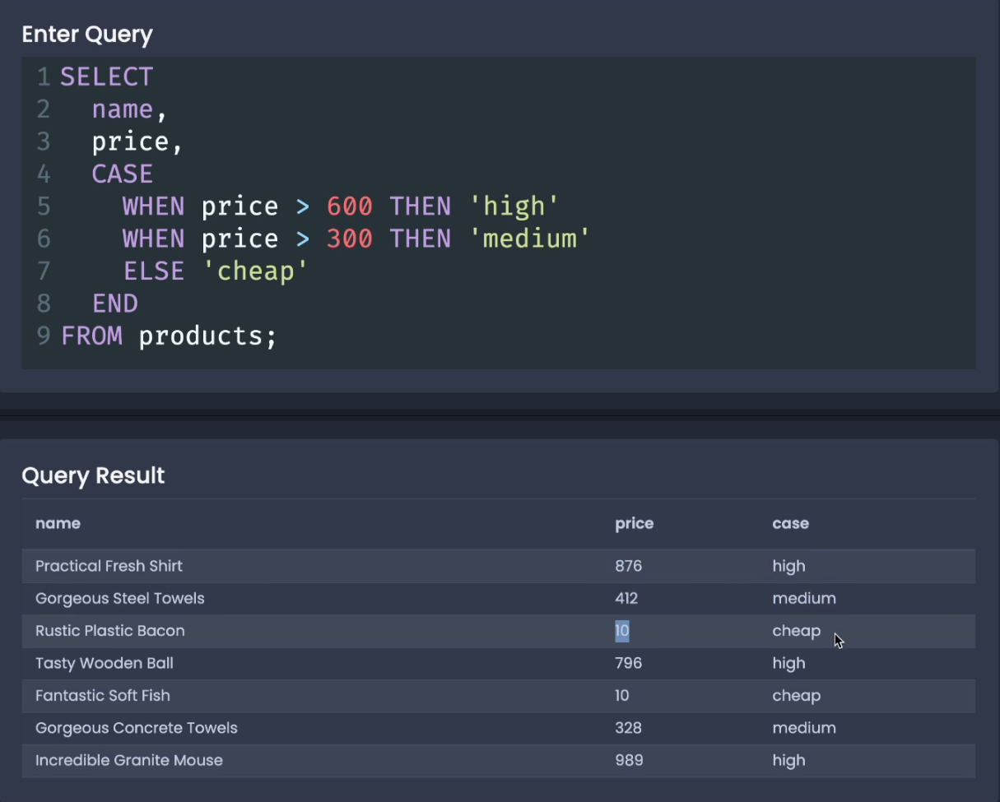

# Section 12 - X

## Section 12

### Linux PostgreSQL and pgAdmin 4 Installation

I am using Linux (Ubuntu 22.10). To download PostgreSQL use:

https://www.postgresql.org/download/linux/ubuntu/

Downloading pgAdmin through the website brought a whole range of issues. What eventually worked was this:

https://stackoverflow.com/questions/69185413/cant-install-pgadmin4-repository-does-not-have-file

Specifically, the answer: 

-------------------

For Ubuntu 22.10 and other versions that complain about apt-key being deprecated, use this:`

`curl -fsS https://www.pgadmin.org/static/packages_pgadmin_org.pub | sudo gpg --dearmor -o /usr/share/keyrings/packages-pgadmin-org.gpg`

`sudo sh -c 'echo "deb [signed-by=/usr/share/keyrings/packages-pgadmin-org.gpg] https://ftp.postgresql.org/pub/pgadmin/pgadmin4/apt/jammy pgadmin4 main" > /etc/apt/sources.list.d/pgadmin4.list && apt update'`

-------------

This is the tutorial i followed, but when it comes to installing pgAdmin, follow the above stackoverflow post. Also, although the tutorial uses the web version, you can use the normal application.

https://www.youtube.com/watch?v=0Il040ExA_Q

## Section 13

pgAdmin is a tool to manage and inspect a postgres database. It can connect to local or remote databases (e.g. ones running through AWS/Azure etc). . It can view/change anything in postgres.

Here's the structure of a postgres server:

<img src=attachment:ed16535d-d9f0-4eff-8c47-ecf8f62c0d78.png width=550 />

We will always only have one database per application.
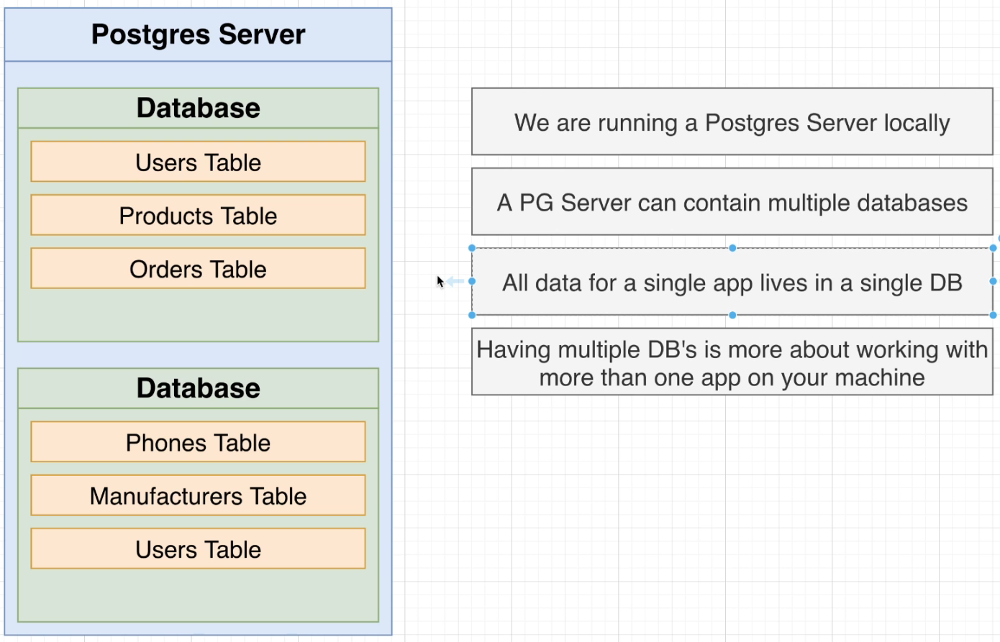

### Datatypes

These are many data *categories*, each containing numerous datatypes. 

<img src=attachment:1e18b812-8f93-4ee5-9307-e27bfc72e47b.png width=500 />
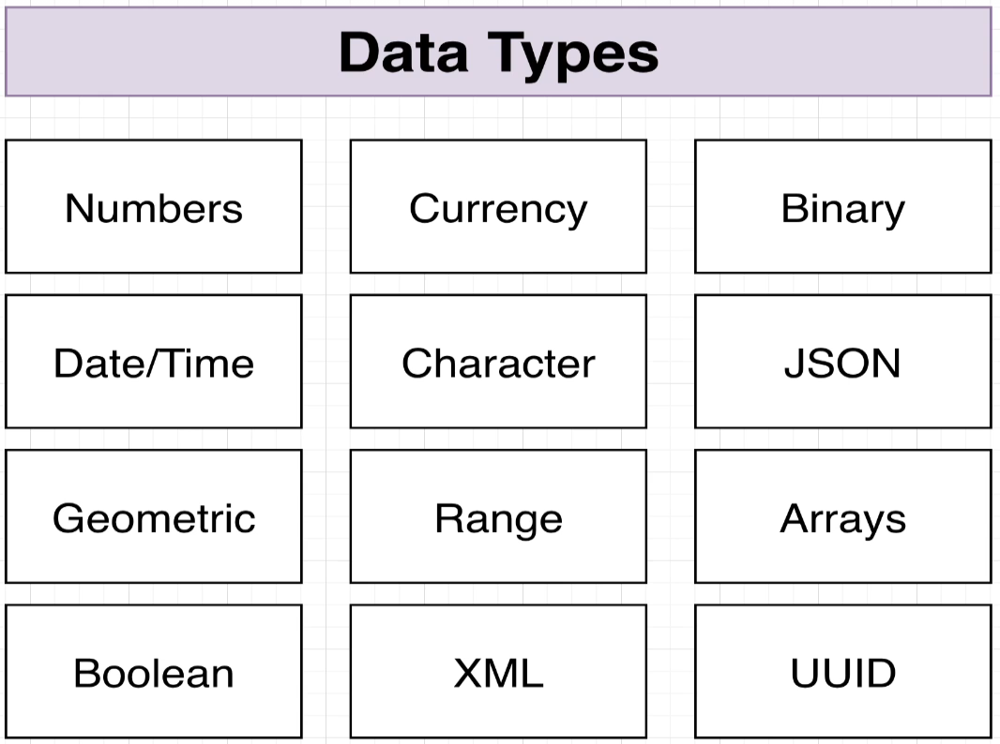

The 4 main categories are:

- Number 
- Date/Time
- Character
- Boolean

<img src=attachment:61ead442-e082-4dd6-96c0-8839323ac1d7.png width=600 /> 

<br>

<img src=attachment:a1cfab54-ba57-4332-9db7-f6675507d281.png width=600 /> 

<br> 

<img src=attachment:e9de4044-cce4-47d5-aece-aa1771f93c5c.png width=600 /> 


**Quick note on postgres:**

In postgres, we can run back-of-the-envelope calculations such as `SELECT 2 + 2`. Postgres will try to assume the datatype, usually as integer or numeric.

But we can assert a particular datatype by using `::`. For example: `SELECT (2.0::INTEGER);` will be asserted as an integer, not a numeric. 


**Numeric Type Notes:**

Real, double precision and float are all treated with floating-point math. So, if we don't need to be extremely precise, these 3 should be used because they are far more efficient.

Numeric and decimal are essentially the same.

**Character Type Notes:**

There are no performance differences betwee any of the 4 types.

**Boolean Type Notes:**

We can tell postgres to treat any of the LHS strings to be equivalent to the associated boolean type on the RHS. For example, 'yes' will be made equivalent to TRUE (`SELECT ('yes'::BOOLEAN);`).


**Date/Time Type Notes:**

Postgres is extremely flexible with date formats. For example, all of the following will be interpreted the same by postgres:

- 1980-11-20
- Nov-20-1980
- 20-Nov-1980
- 1980-November-20
- November 20, 1980

The same is true for times, except there are 3 types for time: `TIME`, `TIME WITH TIME ZONE` and `TIMESTAMP WITH TIME ZONE`. 

Regarding the former, here are some examples of `TIME`:

- 01:23 AM
- 05:23:12 pm (note that this will be converted to 24hr time i.e. 17:23:12)
- 20:34

And here are some examples of `TIME WITH TIME ZONE` (all values will be interpreted to the appropriate UTC value):

- 01:23 AM EST (interpreted as 01:23-05:00)
- 05:23:12 PM PST (interpreted as 17:23:12-08:00)
- 05-23: PM UTC (interpreted as 17:23+00:00)

`TIMESTAMP WITH TIME ZONE` allows us to combine the two above:

- Nov-20-1980 05:23 PM PST (interpreted as 1980-11-20 18:23:00-07)

There is also `INTERVAL` which is just a duration of time. For example:

- 1 day (interpreted as 1 day)
- 1 D (interpreted as 1 day)
- 1 D 2 H 3 M 4 S (interpreted as 1 day 2 hours 3 minutes 4 seconds -> '1 day 02:03:04')

`INTERVAL`s are very useful as numeric operations can be performed on them. For example: 

`SELECT ('NOV-20-1980 1:23 AM EST'::TIMESTAMP WITH TIME ZONE) - ('1 D'::INTERVAL);` -> '1980-11-15 23:23:00-07'

---------------

**Fast Rules**

<img src=attachment:06b31275-ff82-4dba-90c8-baed44d1253f.png width=600 />
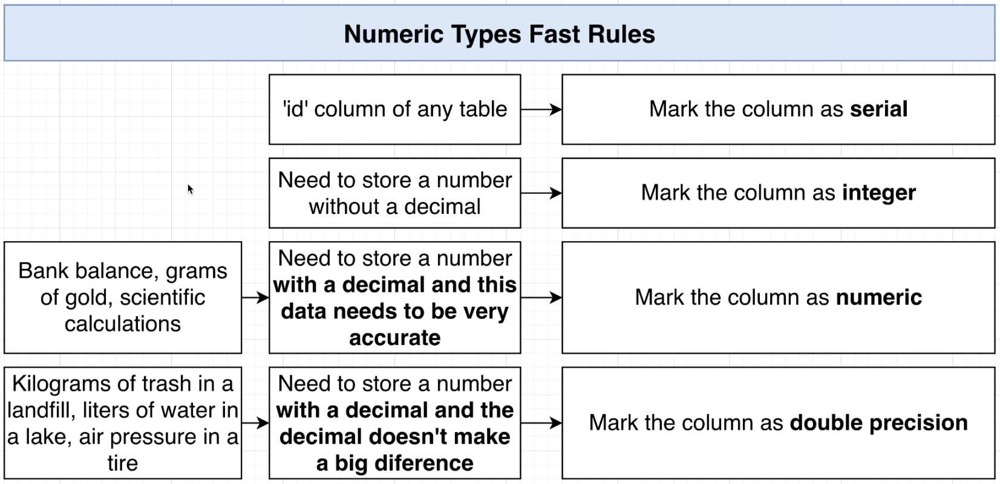
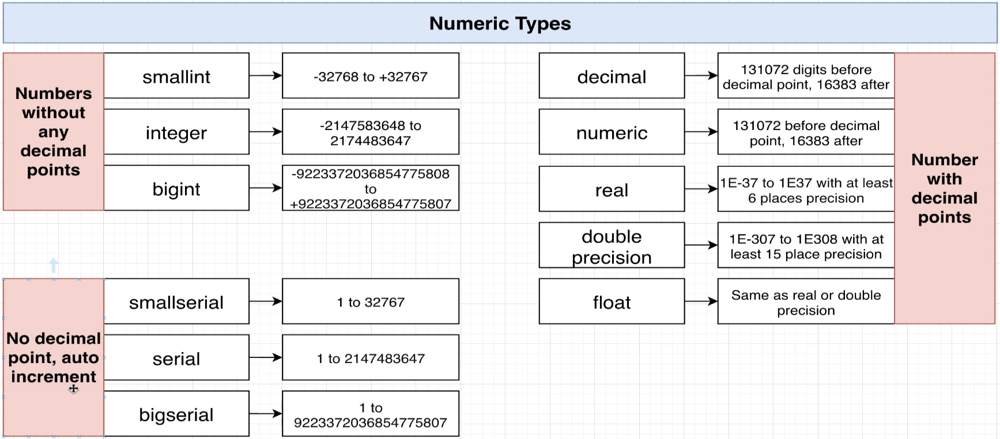
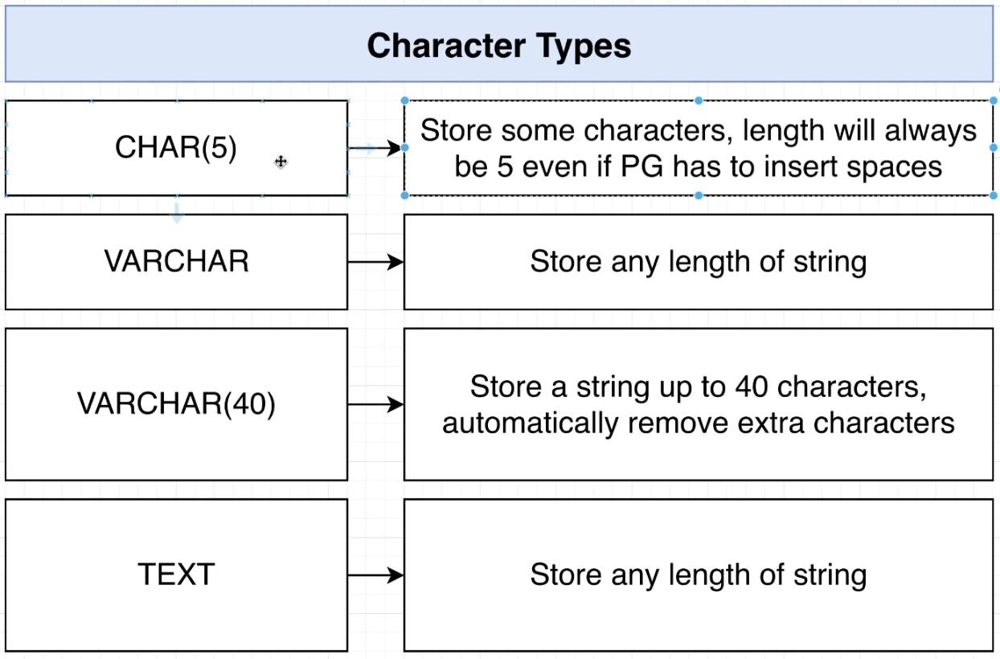
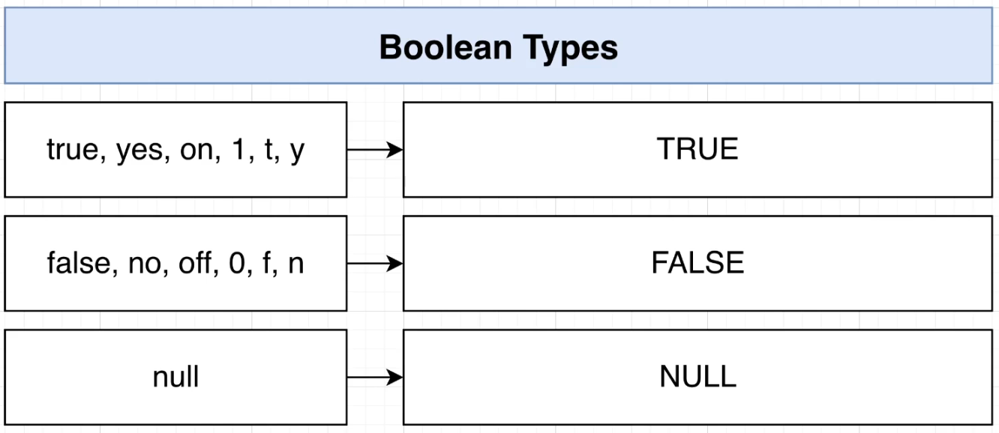

## Section 14

### Using Postgres and pgAdmin

This is the first section of actually using pgAdmin. Throughout this section and the following will be instructions for the basic tools we'll be using throughout the course.

### Validation

**Consider scenario #1 where an admin interacts with a webserver (e.g. an online form) to add a product to a database:**

<img src=attachment:0610a3af-a64e-4e1f-819b-60eb7619b1c0.png width=600 />

But, notice how we the admin has forgot to add the 'weight' information and added a negative price to the product.

A common solution is to add validation at the webserver level e.g. in the Python code. If the criteria are not met, the webserver returns an error to the admin.

**Now consider scenario #2 where there is no webserver, for example in a very small startup:**

The admin can interact with the database via pgAdmin. How can we add validation? 

Below we'll find out methods to add validation to specific tables as well as when to add validation at the database level versus the webserver level.
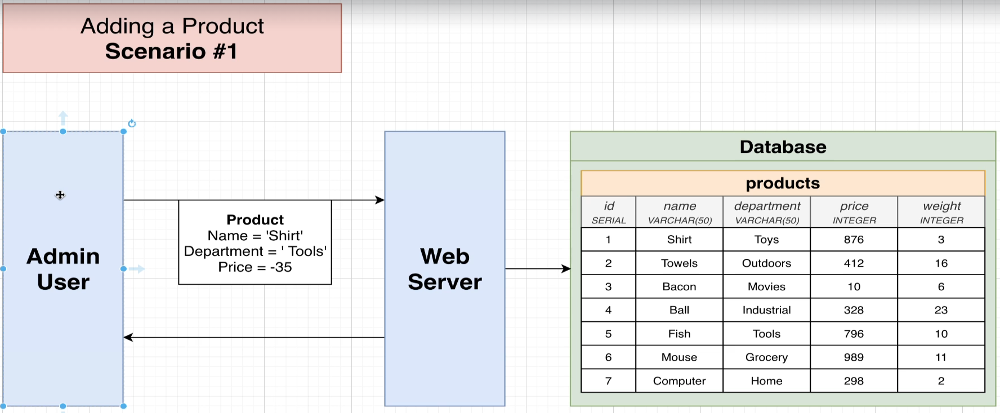

### Row-Level Validation

The three things we can validate for when a row is being inserted/updated are:

- Is a given value unique?
- Is a given value unique in its column?
- Is a given value smaller, greater, equivalent etc. to some other value?

We're going to use pgAdmin for these next parts. 

**Issues**:

If you are unable to create a db by right-clicking on 'database' and clicking 'create' you need to:

- Go to CLI. You will see that your current user is: `nasiq@nasiq-VirtualBox:~`. 
- Change user to 'postgres' user by typing `su postgres`. Your user should update to: `postgres@nasiq-VirtualBox:/home/nasiq`.
- Type `psql` and then `\du`. You may see two users: 'nasiq' and 'postgres' as well as their associated permissions. You need to add all these permissions, but you can only do so from the user which is a superuser. You should see that only 'postgres' is a superuser.
- Click `\q` to quit out of this screen.
- To add each permission, type (taking care of using double quotes, not single, and ending with a semi-colon): 
    * `ALTER ROLE "nasiq" WITH SUPERUSER;`
    * `ALTER ROLE "nasiq" WITH CREATEDB;`
    * `ALTER ROLE "nasiq" WITH CREATEROLE;`
    * `ALTER ROLE "nasiq" WITH REPLICATION;`
    * `ALTER ROLE "nasiq" WITH BYPASSRLS;`
- Type `\du` to ensure they've all been added to user 'nasiq'.
- Restart pgAdmin.
- Rightclicking 'database' and 'create' should now be there/clickable.
    
These links may be useful:\
https://stackoverflow.com/questions/62915202/not-able-to-create-database-in-pgadmin \
https://stackoverflow.com/questions/17633422/psql-fatal-database-user-does-not-exist?rq=1 \
https://stackoverflow.com/questions/43734650/createdb-database-creation-failed-error-permission-denied-to-create-database

To start writing arbitrary queries in pgAdmin, right click the database 'validation' and click 'Query Tool'. All queries written here will apply to the validation database.

Let's create our first table with the following query:

```
CREATE TABLE products (
	id SERIAL PRIMARY KEY,
	name VARCHAR(40),
	department VARCHAR(40);
	price INTEGER,
	weight INTEGER
);
```

To view info on our table do the following:

validation > Schemas > public > Tables > products.

To view the data inside, right-click on 'products' > View/Edit Data > All Rows.

This will open a new window but won't show much as we have no data - let's add some. Firstly, switch over to the other query tab (top-right corner) that we were on before. Type:

```
INSERT INTO products (name, department, price, weight)
VALUES
	('Shirt', 'Clothes', 20, 1)
```

The information won't appear immediately into the other window; we need to re-run the query (`SELECT * FROM public.products...`) within that window by clicking the 'play' symbol.

## Section 15

## Section 16

## Section 17

## Section 18

# Summary of keywords

**Section 1** 

- `CREATE TABLE <name of table>();` : creates table.
- `INSERT INTO <name of table>(<column titles (comma separated)>)`: add columns for the data that we're going to provide. (no semi colon because line is not over)
- `VALUES (<strings or integer values corresponding to the columns of our data>);` : Add 1 row (now add semicolon to end the line).
- 
```
VALUES 
    (<strings or integer values corresponding to the columns of our data>),
    (<strings or integer values corresponding to the columns of our data>),
    (<strings or integer values corresponding to the columns of our data>);`
```
: Add multiple rows.
- `SELECT * FROM <table name>`: select all columns from our table.
- `SELECT <specific column names, comma-separated> FROM <table>`: select specific columns from our table
- `SELECT <column x> <operator> <column y> FROM <table>;` perform calculations for each row e.g dividing population column by area column to get density column for all rows. 
- `SELECT <column x> <operator> <column y> AS <new name> FROM <table>;` : give column title to the temporary column
- `SELECT UPPER(CONCAT(name, ', ', country)) AS location FROM cities;`: example of combining functions

**Section 2**

- `SELECT <column x> FROM <table> WHERE <condition>;`: Filter our data based on a condition e.g. `WHERE area > 4000`.
- 
```
WHERE
    <condition one>
    AND/OR <condition two>
    AND/OR <condition three>;
```
: Filter for multiple conditions
- `UPDATE <table> SET <column heading> = <value> WHERE <condition;` : Update a record based on some condtion.
- `DELETE FROM <table> WHERE <condition>;`: Deletes the entire row of any record satisfying the condition.

**Section 3**

- `id SERIAL PRIMARY KEY`: Creates a column of primary keys with unique IDs that are auto-incremented and auto-generated.
- `<owner's column>_id INTEGER REFERENCES <owner's table>(<primary key of owner, usually 'id'>)`: Create a foreign key column that is owned by some owner in a different table (example below).
- `user_id INTEGER REFERENCES users(id)` : foreign key example.
- `DROP TABLE <name of table>;` : Deletes a table.
- `<foreign key definition> ON DELETE <delete behaviour>`: When creating a table, this sets the delete behaviour when the row that the foreign key refers to is deleted. See below for example.
- `user_id INTEGER REFERENCES users(id) ON DELETE CASCADE`: (Part of the photos table,) sets delete behaviour when row(s) in the users table are deleted. Rows in the photos table are deleted as a result.

**Section 4**

- \
```
SELECT <col heading from temp table>, <col heading from temp table>
FROM <table that we want to iterate through>
JOIN <table that we want to relate> ON <col from iterated table> = <column from related table>;
```
: Used to select two columns (in this case) from a temporary table created via `JOIN`. The temporary table starts off as the table following the `FROM`, and is then extended with the table following the `JOIN`. Example below. 
- \
```
SELECT contents, username
FROM comments
JOIN users ON users.id = comments.user_id;
```
: Example of a `JOIN` statement. Schema can be found in Section 4. We can filter further using a `WHERE` statement *after* the `JOIN`. If we have multiple `JOIN`s then the `WHERE` comes at the end.

**Section 5**

- \
```
SELECT <grouped_column or aggregate func>, <grouped_column or aggregate func>
FROM <table>
GROUP BY <column in table>;
```
: GROUP BY statement that groups rows together that share the same \<column in table> value. We can apply an aggregate function to each group to extract a single value from each group. Example below.
- \
```
SELECT user_id, count(id)
FROM comments
GROUP BY user_id;
```
: For each user (with unique user_id), counts the number of comments made by them. (All comments made by a particular user share the same `user_id`, so they all get grouped together.)
- \
```
SELECT <grouped_column or aggregate func>, <grouped_column or aggregate func>
FROM <table>
WHERE <some condition on rows>
GROUP BY <column in table>
HAVING <aggregate func> <condition>
```
: Typical structure of a `HAVING` query. Example below.
- \
```
SELECT photo_id, COUNT(*)
FROM comments
WHERE photo_id < 3
GROUP BY photo_id
HAVING COUNT(*) > 2
```
: Finds the number of comments for each photo where the `photo_id` is less than 3 and the photo has more than 2 comments.

**Section 6**

(blank)

**Section 7**

- `SELECT * FROM <table> ORDER BY <column heading>` : Displays all columns in a table sorted from smallest to biggest for the stated column heading. 
- `SELECT * FROM <table> ORDER BY <column heading> DESC` : Same as above but in descending order (ascending 'ASC' by default).
- `OFFSET <number of rows to skip>` : Removes the first x rows from our selection
- `LIMIT <number of rows to show>` : Limits our selection to the number of rows we state.

**Section 8**

- `(<query 1>) UNION (<query 2>)` : Outputs the union rows of the two statements. Replace `UNION` with `UNION ALL` if you want to keep duplicates.
- `(<query 1>) INTERSECT (<query 2>)` : Computers the intersecting rows of the two statements. Replace `INTERSECT` with `INTERSECT ALL` if you want to keep duplicates. Note, this doesn't mean that if each query has the same row, the row will appear twice; rather, if each query has *multiple* repeated rows, these will be kept.
- `(<query 1>) EXCEPT (<query 2>)` : Keep all rows in query 1 that are not present in query 2. Replace `EXCEPT` with `EXCEPT ALL` if you want to keep duplicates.

**Section 9**

- `SELECT <..query continues> WHERE <some column> <operator> (<subquery>)` : Structure of basic subquery. Example below.
- `SELECT name FROM prodcuts WHERE price > (SELECT MAX(price) from...);`: Example of basic subquery.
- `<query begins...> WHERE <some column heading> <= ALL <some column>`: Example of an `ALL` statement. Each row in the main query is kept if its associated value is greater than *all* values in the column following the `ALL` keyword. The 'less than or equal to' operator has been used in conjunction with the `ALL` but we could use any other comparison / equality operator.
- `<query begins...> WHERE <some column> <= SOME <some column>`: Example of a `SOME` statement. Note that `ANY` is an alias of `SOME`. Each row in the main query is kept if its associated value is greater than *at least one* value in the column following the `SOME` keyword. The 'less than or equal to' operator has been used in conjunction with the `SOME` but we could use any other comparison / equality operator.

**Section 10**

- `SELECT DISTINCT <name of column>`: Returns unique values within specified column.
- `SELECT COUNT(DISTINCT <name of column>)`: Returns number of unique values within specified column.

**Section 11**

- `SELECT GREATEST(<list of comma-separated arguments>)`: Returns the greatest value out of the arguments.
- `SELECT LEAST(<list of comma-separated arguments>)`: Returns the smallest value out of the arguments.
- 
```
SELECT 
  <col>
  <col>
  CASE
    WHEN <condition> THEN '<value>'
    WHEN <condition> THEN '<value>'
    ELSE <'value'>
  END
FROM <table>
```
: Creates an additional column called 'case'; the values in this column are determined by the conditions.

**Section 12**

(blank)

**Section 13**

Datatypes section; see full section for all keywords.